# Load datasets

In [1]:
import os

def load_captions(captions_folder, image_folder):
    captions = {}
    image_files = os.listdir(image_folder)
    for image_file in image_files:
        image_name = image_file.split('.')[0]
        caption_file = os.path.join(captions_folder, image_name + ".txt")
        with open(caption_file, "r") as f:
            caption = f.readlines()[0].strip() # only read first caption
        if image_name not in captions:
                captions[image_name] = caption
    return captions

In [2]:
captions_folder = "./cvpr2016_flowers/captions"
image_folder = "./cvpr2016_flowers/images"

captions = load_captions(captions_folder, image_folder)

# Caption Encoding

In [3]:
import torch
import numpy as np
from sentence_transformers import SentenceTransformer

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

bert_model = SentenceTransformer("all-mpnet-base-v2").to(device)

def encode_captions(captions):
    encoded_captions = {}
    for image_name in captions.keys():
        caption = captions[image_name]
        encoded_captions[image_name] = {
            'embed': torch.tensor(bert_model.encode(caption)),
            'text': caption
        }
    return encoded_captions

c:\Users\Admin\miniconda3\envs\tf-gpu\lib\site-packages\transformers\tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [4]:
encoded_captions = encode_captions(captions)

# Preprocessing

In [5]:
import os
import torch
import numpy as np
from PIL import Image
from torch.utils.data import Dataset
import random

class FlowerDataset(Dataset):
    def __init__(self, img_dir, captions, transform=None):
        self.img_dir = img_dir
        self.transform = transform

        # Load captions
        self.captions = captions
        self.img_names = list(self.captions.keys())
        
        self.cache = {}

    def __len__(self):
        return len(self.img_names)
    
    # cache images for faster loading can help with faster training
    def load_image(self, img_path):
        if img_path in self.cache:
            return self.cache[img_path]
        image = Image.open(img_path).convert("RGB")
        if self.transform:
            image = self.transform(image)
        self.cache[img_path] = image
        return image

    def __getitem__(self, idx):
        img_name = self.img_names[idx]
        img_path = os.path.join(self.img_dir, img_name + ".jpg")
        image = self.load_image(img_path)

        encoded_caption = self.captions[img_name]['embed']
        caption = self.captions[img_name]['text']

        wrong_idx = random.choice([i for i in range(len(self.img_names)) if i != idx])
        wrong_img_name = self.img_names[wrong_idx]
        wrong_img_path = os.path.join(self.img_dir, wrong_img_name + ".jpg")
        wrong_image = self.load_image(wrong_img_path)

        return {
            'image': image,
            'embed_caption': encoded_caption,
            'text': caption,
            'wrong_image': wrong_image
        }


In [6]:
import torchvision.transforms as transforms

IMG_SIZE = 128

transform = transforms.Compose([
    transforms.Resize((IMG_SIZE, IMG_SIZE)),
    transforms.ToTensor(),
    transforms.Normalize([0.5], [0.5])
])

ds = FlowerDataset(
    img_dir="./cvpr2016_flowers/images",
    captions=encoded_captions,
    transform=transform
)

In [7]:
import matplotlib.pyplot as plt

def show_grid(img):
  npimg = img.numpy()
  plt.imshow(np.transpose(npimg, (1, 2, 0)))
  plt.show()

In [8]:
next(iter(ds))['embed_caption'].shape

torch.Size([768])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


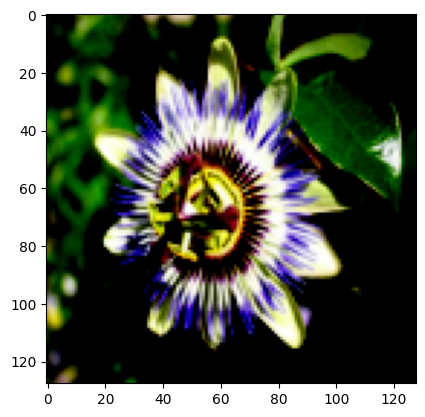

In [9]:
show_grid(next(iter(ds))['image'])

In [10]:
from torch.utils.data import DataLoader

BATCH_SIZE = 512
dataloader = DataLoader(ds, batch_size=BATCH_SIZE, shuffle=True)

# Model

## Generator

In [11]:
import torch.nn as nn

class Generator(nn.Module):

    def __init__(self, noise_size, feature_size, num_channels, embedding_size, reduced_dim_size):
        super(Generator, self).__init__()
        self.reduced_dim_size = reduced_dim_size #embedding_size = 768 -->256
        self.textEncoder = nn.Sequential(
            nn.Linear(embedding_size, reduced_dim_size),
            nn.BatchNorm1d(reduced_dim_size),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self.upsamplingBlock = nn.Sequential(
            # 256 + 100 --> 1024
            nn.ConvTranspose2d(noise_size + reduced_dim_size, feature_size * 8, kernel_size=4, stride=1, padding=0, bias=True),
            nn.BatchNorm2d(feature_size * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # 1024 --> 512
            nn.ConvTranspose2d(feature_size * 8, feature_size * 4, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(feature_size * 4),
            nn.ReLU(inplace=True),
            # 512 --> 256
            nn.ConvTranspose2d(feature_size * 4, feature_size * 2, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(feature_size * 2),
            nn.ReLU(inplace=True),
            # 256 --> 128
            nn.ConvTranspose2d(feature_size * 2, feature_size, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(feature_size),
            nn.ReLU(inplace=True),
            # 128 --> 128
            nn.ConvTranspose2d(feature_size, feature_size, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(feature_size),
            nn.ReLU(inplace=True),
            # 128 --> 3
            nn.ConvTranspose2d(feature_size, num_channels, kernel_size=4, stride=2, padding=1, bias=True),
            nn.Tanh()
        ) # output: (Batch, 3, 128, 128)

    def forward(self, noise, text_embeddings):
        encoded_text = self.textEncoder(text_embeddings)
        input = torch.cat((noise, encoded_text), dim=1).unsqueeze(2).unsqueeze(2)
        output = self.upsamplingBlock(input)
        return output    

## Discriminator

In [12]:
class Discriminator(nn.Module):

    def __init__(self, num_channels, feature_size, embedding_size, reduced_dim_size):
        super(Discriminator, self).__init__()
        self.reduced_dim_size = reduced_dim_size
        self.imageEncoder = nn.Sequential(
            # 3 --> 128
            nn.Conv2d(num_channels, feature_size, kernel_size=4, stride=2, padding=1, bias=True),
            nn.LeakyReLU(0.2, inplace=True),
            # 128 --> 128
            nn.Conv2d(feature_size, feature_size, kernel_size=4, stride=2, padding=1, bias=True),
            nn.LeakyReLU(0.2, inplace=True),
            # 128 --> 256
            nn.Conv2d(feature_size, feature_size * 2, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(feature_size * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # 256 --> 512
            nn.Conv2d(feature_size * 2, feature_size * 4, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(feature_size * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # 512 --> 1024
            nn.Conv2d(feature_size * 4, feature_size * 8, kernel_size=4, stride=2, padding=1, bias=True),
            nn.BatchNorm2d(feature_size * 8),
            nn.LeakyReLU(0.2, inplace=True), 
        ) # (Batch, 1024, 4, 4)

        self.textEncoder = nn.Sequential(
            nn.Linear(embedding_size, reduced_dim_size),
            nn.BatchNorm1d(reduced_dim_size),
            nn.LeakyReLU(0.2, inplace=True)
        )

        self.finalBlock = nn.Sequential(
            nn.Conv2d(feature_size * 8 + reduced_dim_size, 1, 4, 1, 0, bias=True),
        ) # (Batch, 1, 1, 1)
    def forward(self, input_img, text_embeddings):
        image_encoded = self.imageEncoder(input_img)
        text_encoded = self.textEncoder(text_embeddings)
        replicated_text = text_encoded.repeat(4, 4, 1, 1).permute(2, 3, 0, 1)
        concat_input = torch.cat([image_encoded, replicated_text], dim=1)
        x = self.finalBlock(concat_input)
        return x.view(-1, 1), image_encoded

# Training

In [13]:
import torchvision

plt_o_text_embeddings = ds[0]['embed_caption'].unsqueeze(0)
fixed_noise = torch.randn(size=(1, 100))

def plot_output(generator):
  plt.clf()
  with torch.no_grad():

    generator.eval()
    test_images = generator(fixed_noise.to(device), plt_o_text_embeddings.to(device))
    generator.train()

    grid = torchvision.utils.make_grid(test_images.cpu(), normalize=True)
    show_grid(grid)

In [14]:
discriminator = Discriminator(3, 128, 768, 256).to(device)
generator = Generator(100, 128, 3, 768, 256).to(device)
bce_loss = nn.BCEWithLogitsLoss()
l2_loss = nn.MSELoss()
l1_loss = nn.L1Loss()

import torch.optim as optim

optimizer_G = optim.Adam(generator.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizer_D = optim.Adam(discriminator.parameters(), lr=0.0002, betas=(0.5, 0.999))

Epoch [1/1000] loss_D: 2.4684 loss_G: 3.9707 time: 31.27
Epoch [2/1000] loss_D: 1.1283 loss_G: 2.7299 time: 9.18
Epoch [3/1000] loss_D: 1.2532 loss_G: 2.4283 time: 9.09
Epoch [4/1000] loss_D: 1.2332 loss_G: 2.2995 time: 9.19
Epoch [5/1000] loss_D: 1.2726 loss_G: 2.1612 time: 9.18
Epoch [6/1000] loss_D: 1.1729 loss_G: 2.0864 time: 9.31
Epoch [7/1000] loss_D: 1.1874 loss_G: 2.2771 time: 11.15
Epoch [8/1000] loss_D: 1.2863 loss_G: 2.0163 time: 11.48
Epoch [9/1000] loss_D: 1.2711 loss_G: 2.1054 time: 11.39


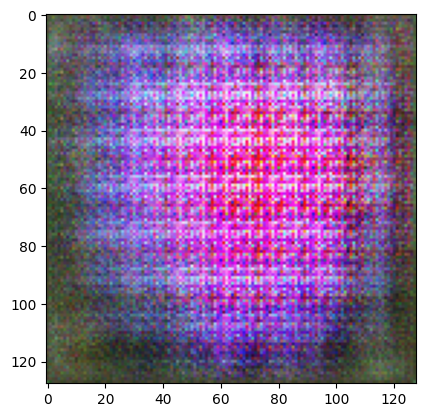

Epoch [10/1000] loss_D: 1.2385 loss_G: 2.2545 time: 11.65
Epoch [11/1000] loss_D: 1.1226 loss_G: 2.0498 time: 11.46
Epoch [12/1000] loss_D: 1.1864 loss_G: 2.2381 time: 11.36
Epoch [13/1000] loss_D: 1.1685 loss_G: 2.3299 time: 11.50
Epoch [14/1000] loss_D: 1.3060 loss_G: 2.1451 time: 11.36
Epoch [15/1000] loss_D: 1.1874 loss_G: 2.1555 time: 11.48
Epoch [16/1000] loss_D: 1.1800 loss_G: 2.2796 time: 11.44
Epoch [17/1000] loss_D: 1.2490 loss_G: 2.1977 time: 11.54
Epoch [18/1000] loss_D: 1.2289 loss_G: 2.1470 time: 11.48
Epoch [19/1000] loss_D: 1.2144 loss_G: 2.1153 time: 11.39


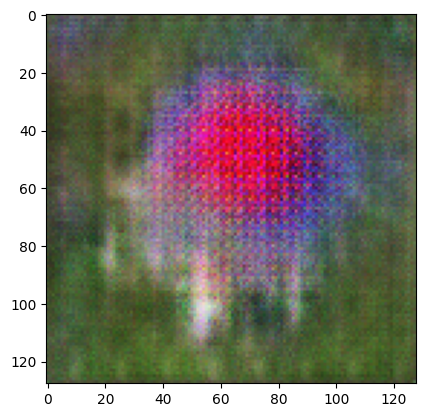

Epoch [20/1000] loss_D: 1.2508 loss_G: 2.1338 time: 11.63
Epoch [21/1000] loss_D: 1.2832 loss_G: 2.0436 time: 11.27
Epoch [22/1000] loss_D: 1.2318 loss_G: 2.0200 time: 11.46
Epoch [23/1000] loss_D: 1.1809 loss_G: 2.0952 time: 9.67
Epoch [24/1000] loss_D: 1.2975 loss_G: 1.9841 time: 9.18
Epoch [25/1000] loss_D: 1.2403 loss_G: 1.9646 time: 9.28
Epoch [26/1000] loss_D: 1.2932 loss_G: 1.9871 time: 9.51
Epoch [27/1000] loss_D: 1.2575 loss_G: 2.0020 time: 9.35
Epoch [28/1000] loss_D: 1.2687 loss_G: 1.9253 time: 9.42
Epoch [29/1000] loss_D: 1.3298 loss_G: 1.9497 time: 9.50


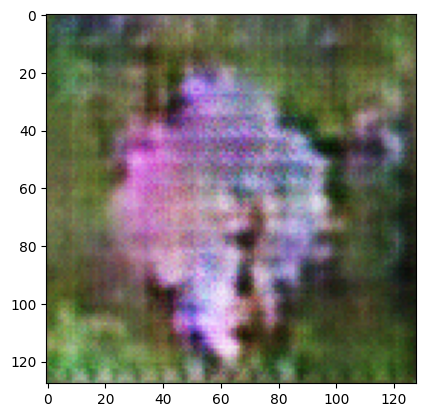

Epoch [30/1000] loss_D: 1.2999 loss_G: 1.8722 time: 9.28
Epoch [31/1000] loss_D: 1.3109 loss_G: 1.8935 time: 9.22
Epoch [32/1000] loss_D: 1.2484 loss_G: 1.8778 time: 9.30
Epoch [33/1000] loss_D: 1.2476 loss_G: 1.8991 time: 9.35
Epoch [34/1000] loss_D: 1.2948 loss_G: 1.8298 time: 9.29
Epoch [35/1000] loss_D: 1.3236 loss_G: 1.7901 time: 9.50
Epoch [36/1000] loss_D: 1.2903 loss_G: 1.7879 time: 9.42
Epoch [37/1000] loss_D: 1.2779 loss_G: 1.8573 time: 9.48
Epoch [38/1000] loss_D: 1.3170 loss_G: 1.7923 time: 9.45
Epoch [39/1000] loss_D: 1.3359 loss_G: 1.7534 time: 9.48


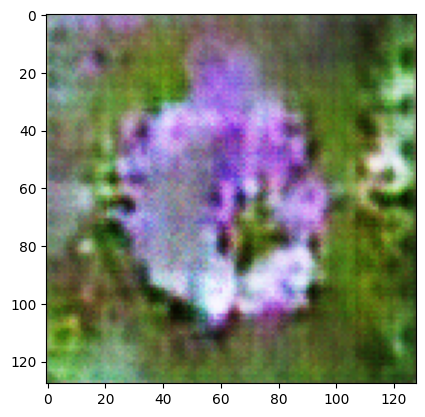

Epoch [40/1000] loss_D: 1.2819 loss_G: 1.8091 time: 9.52
Epoch [41/1000] loss_D: 1.3098 loss_G: 1.7053 time: 9.57
Epoch [42/1000] loss_D: 1.3062 loss_G: 1.7519 time: 9.37
Epoch [43/1000] loss_D: 1.3304 loss_G: 1.8350 time: 9.42
Epoch [44/1000] loss_D: 1.2952 loss_G: 1.7183 time: 9.26
Epoch [45/1000] loss_D: 1.4041 loss_G: 1.7497 time: 9.34
Epoch [46/1000] loss_D: 1.2191 loss_G: 1.7611 time: 9.39
Epoch [47/1000] loss_D: 1.4426 loss_G: 1.7498 time: 9.34
Epoch [48/1000] loss_D: 1.1998 loss_G: 1.7403 time: 9.36
Epoch [49/1000] loss_D: 1.3733 loss_G: 1.7066 time: 9.41


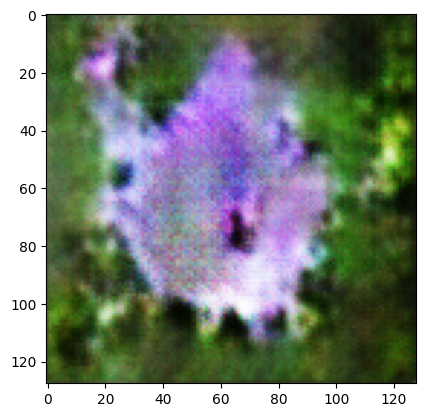

Epoch [50/1000] loss_D: 1.3022 loss_G: 1.6818 time: 9.54
Epoch [51/1000] loss_D: 1.3547 loss_G: 1.7206 time: 9.49
Epoch [52/1000] loss_D: 1.2689 loss_G: 1.6764 time: 9.49
Epoch [53/1000] loss_D: 1.2958 loss_G: 1.6321 time: 9.40
Epoch [54/1000] loss_D: 1.3573 loss_G: 1.7106 time: 9.56
Epoch [55/1000] loss_D: 1.3162 loss_G: 1.6703 time: 9.38
Epoch [56/1000] loss_D: 1.3001 loss_G: 1.7112 time: 9.48
Epoch [57/1000] loss_D: 1.2889 loss_G: 1.6532 time: 9.41
Epoch [58/1000] loss_D: 1.3257 loss_G: 1.7155 time: 9.49
Epoch [59/1000] loss_D: 1.2810 loss_G: 1.6832 time: 9.40


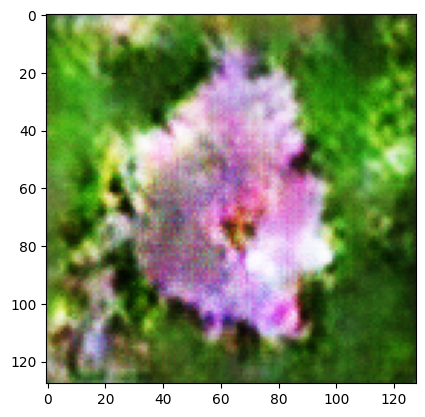

Epoch [60/1000] loss_D: 1.3284 loss_G: 1.6616 time: 9.63
Epoch [61/1000] loss_D: 1.3167 loss_G: 1.7366 time: 9.36
Epoch [62/1000] loss_D: 1.3114 loss_G: 1.7078 time: 9.33
Epoch [63/1000] loss_D: 1.3176 loss_G: 1.6629 time: 9.39
Epoch [64/1000] loss_D: 1.3070 loss_G: 1.6545 time: 9.40
Epoch [65/1000] loss_D: 1.3200 loss_G: 1.7486 time: 9.47
Epoch [66/1000] loss_D: 1.2976 loss_G: 1.6904 time: 9.40
Epoch [67/1000] loss_D: 1.2734 loss_G: 1.7420 time: 9.43
Epoch [68/1000] loss_D: 1.2689 loss_G: 1.7990 time: 9.38
Epoch [69/1000] loss_D: 1.3463 loss_G: 1.6915 time: 9.42


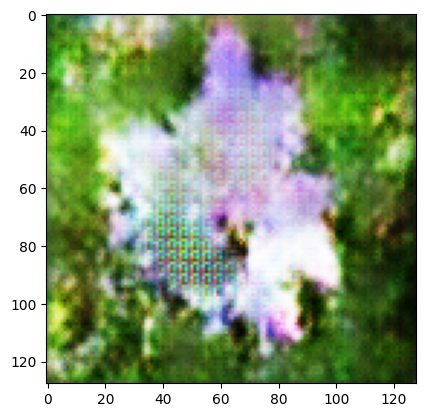

Epoch [70/1000] loss_D: 1.2483 loss_G: 1.7282 time: 9.53
Epoch [71/1000] loss_D: 1.4430 loss_G: 1.7811 time: 9.47
Epoch [72/1000] loss_D: 1.2778 loss_G: 1.6175 time: 9.41
Epoch [73/1000] loss_D: 1.3153 loss_G: 1.6708 time: 9.39
Epoch [74/1000] loss_D: 1.2589 loss_G: 1.8015 time: 9.31
Epoch [75/1000] loss_D: 1.2672 loss_G: 1.7439 time: 9.37
Epoch [76/1000] loss_D: 1.3001 loss_G: 1.7183 time: 10.54
Epoch [77/1000] loss_D: 1.2989 loss_G: 1.7854 time: 11.41
Epoch [78/1000] loss_D: 1.2761 loss_G: 1.7713 time: 11.30
Epoch [79/1000] loss_D: 1.2993 loss_G: 1.6437 time: 11.23


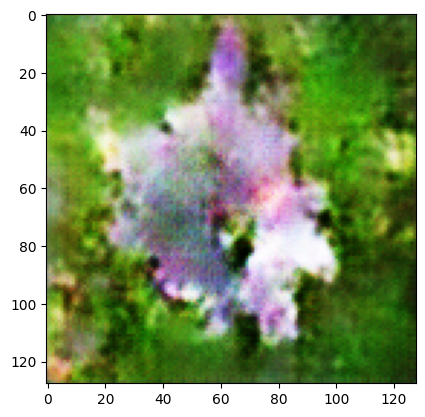

Epoch [80/1000] loss_D: 1.2719 loss_G: 1.8255 time: 11.52
Epoch [81/1000] loss_D: 1.3407 loss_G: 1.7507 time: 11.43
Epoch [82/1000] loss_D: 1.2119 loss_G: 1.7931 time: 11.25
Epoch [83/1000] loss_D: 1.5719 loss_G: 1.8007 time: 11.19
Epoch [84/1000] loss_D: 1.3010 loss_G: 1.4926 time: 11.49
Epoch [85/1000] loss_D: 1.3837 loss_G: 1.5265 time: 11.21
Epoch [86/1000] loss_D: 1.3848 loss_G: 1.5526 time: 11.01
Epoch [87/1000] loss_D: 1.3575 loss_G: 1.5178 time: 11.52
Epoch [88/1000] loss_D: 1.2926 loss_G: 1.5790 time: 11.36
Epoch [89/1000] loss_D: 1.3399 loss_G: 1.6962 time: 9.97


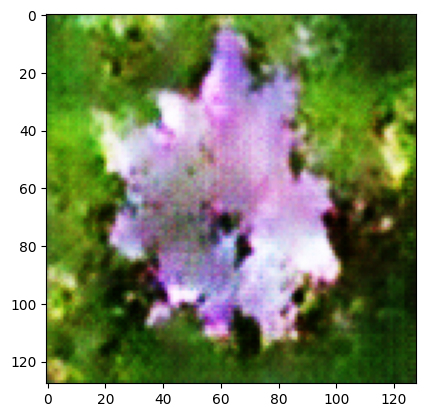

Epoch [90/1000] loss_D: 1.2535 loss_G: 1.6790 time: 10.79
Epoch [91/1000] loss_D: 1.2779 loss_G: 1.7607 time: 11.69
Epoch [92/1000] loss_D: 1.2717 loss_G: 1.7534 time: 11.37
Epoch [93/1000] loss_D: 1.2789 loss_G: 1.7077 time: 11.83
Epoch [94/1000] loss_D: 1.2387 loss_G: 1.8416 time: 11.51
Epoch [95/1000] loss_D: 1.3952 loss_G: 1.7794 time: 11.62
Epoch [96/1000] loss_D: 1.2992 loss_G: 1.5402 time: 11.41
Epoch [97/1000] loss_D: 1.2718 loss_G: 1.6629 time: 11.29
Epoch [98/1000] loss_D: 1.3193 loss_G: 1.7231 time: 11.22
Epoch [99/1000] loss_D: 1.2539 loss_G: 1.8225 time: 11.21


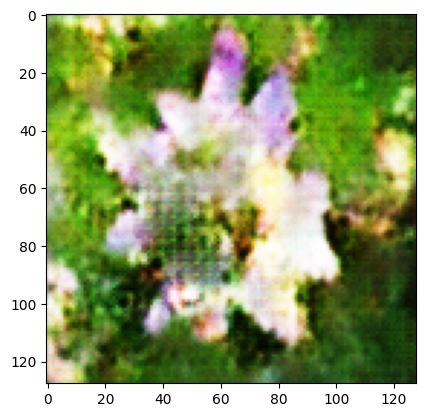

Epoch [100/1000] loss_D: 1.1922 loss_G: 1.8014 time: 11.33
Epoch [101/1000] loss_D: 1.2378 loss_G: 1.8061 time: 11.11
Epoch [102/1000] loss_D: 1.3036 loss_G: 1.7901 time: 11.10
Epoch [103/1000] loss_D: 1.2626 loss_G: 1.8964 time: 10.98
Epoch [104/1000] loss_D: 1.1868 loss_G: 1.8454 time: 11.04
Epoch [105/1000] loss_D: 1.2380 loss_G: 1.8554 time: 11.34
Epoch [106/1000] loss_D: 1.2707 loss_G: 1.7960 time: 11.09
Epoch [107/1000] loss_D: 1.2093 loss_G: 1.8014 time: 11.14
Epoch [108/1000] loss_D: 1.2735 loss_G: 1.8647 time: 11.25
Epoch [109/1000] loss_D: 1.1771 loss_G: 1.8745 time: 11.24


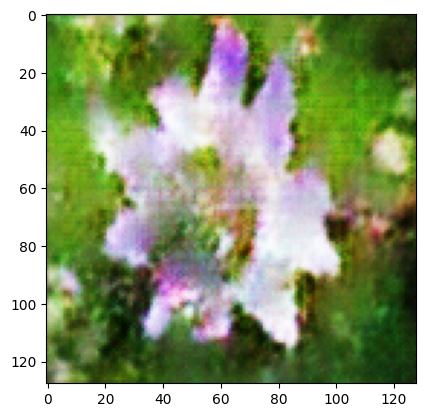

Epoch [110/1000] loss_D: 1.2625 loss_G: 1.9416 time: 11.39
Epoch [111/1000] loss_D: 1.1842 loss_G: 1.8667 time: 11.17
Epoch [112/1000] loss_D: 1.2422 loss_G: 1.8643 time: 11.15
Epoch [113/1000] loss_D: 1.2000 loss_G: 1.8873 time: 11.20
Epoch [114/1000] loss_D: 1.2105 loss_G: 1.9050 time: 11.24
Epoch [115/1000] loss_D: 1.2157 loss_G: 1.8903 time: 11.35
Epoch [116/1000] loss_D: 1.4027 loss_G: 1.9316 time: 11.36
Epoch [117/1000] loss_D: 1.2737 loss_G: 1.5326 time: 11.29
Epoch [118/1000] loss_D: 1.1708 loss_G: 1.9226 time: 11.17
Epoch [119/1000] loss_D: 1.2952 loss_G: 1.8176 time: 11.44


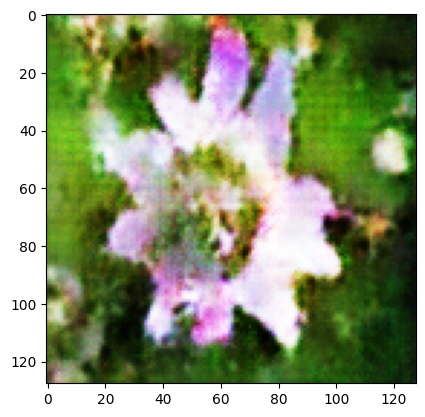

Epoch [120/1000] loss_D: 1.2061 loss_G: 1.8409 time: 11.38
Epoch [121/1000] loss_D: 1.2025 loss_G: 1.8968 time: 11.42
Epoch [122/1000] loss_D: 1.1573 loss_G: 2.0281 time: 10.08
Epoch [123/1000] loss_D: 1.2214 loss_G: 1.8935 time: 9.21
Epoch [124/1000] loss_D: 1.2116 loss_G: 1.9172 time: 9.54
Epoch [125/1000] loss_D: 1.2564 loss_G: 1.9033 time: 9.06
Epoch [126/1000] loss_D: 1.1993 loss_G: 1.8706 time: 9.07
Epoch [127/1000] loss_D: 1.1941 loss_G: 1.8599 time: 9.07
Epoch [128/1000] loss_D: 1.3183 loss_G: 1.7426 time: 9.11
Epoch [129/1000] loss_D: 1.2231 loss_G: 1.9100 time: 9.08


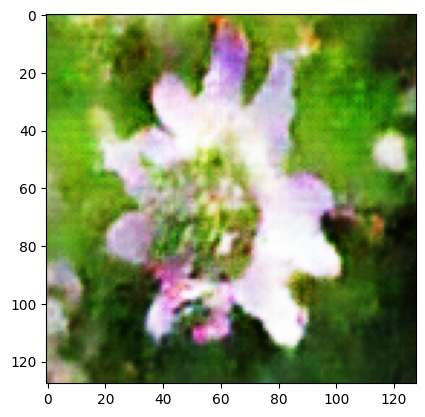

Epoch [130/1000] loss_D: 1.2456 loss_G: 1.8723 time: 9.16
Epoch [131/1000] loss_D: 1.1526 loss_G: 1.9852 time: 9.10
Epoch [132/1000] loss_D: 1.1781 loss_G: 1.9640 time: 9.08
Epoch [133/1000] loss_D: 1.1437 loss_G: 2.0062 time: 9.09
Epoch [134/1000] loss_D: 1.3816 loss_G: 1.6803 time: 9.08
Epoch [135/1000] loss_D: 1.2513 loss_G: 1.7605 time: 9.08
Epoch [136/1000] loss_D: 1.2051 loss_G: 1.8773 time: 9.07
Epoch [137/1000] loss_D: 1.2345 loss_G: 1.8700 time: 9.08
Epoch [138/1000] loss_D: 1.2357 loss_G: 1.8448 time: 9.08
Epoch [139/1000] loss_D: 1.2231 loss_G: 1.9106 time: 9.09


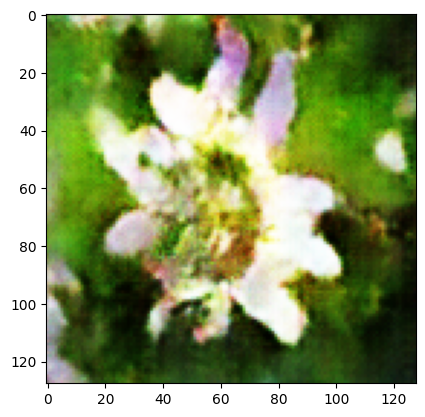

Epoch [140/1000] loss_D: 1.1923 loss_G: 1.8966 time: 9.23
Epoch [141/1000] loss_D: 1.2132 loss_G: 1.9452 time: 9.10
Epoch [142/1000] loss_D: 1.1942 loss_G: 1.8736 time: 9.09
Epoch [143/1000] loss_D: 1.2099 loss_G: 1.8760 time: 9.07
Epoch [144/1000] loss_D: 1.2829 loss_G: 2.0168 time: 9.09
Epoch [145/1000] loss_D: 1.2337 loss_G: 1.7788 time: 9.05
Epoch [146/1000] loss_D: 1.1795 loss_G: 1.9067 time: 9.06
Epoch [147/1000] loss_D: 1.2558 loss_G: 1.8281 time: 9.06
Epoch [148/1000] loss_D: 1.2473 loss_G: 1.8179 time: 9.05
Epoch [149/1000] loss_D: 1.2085 loss_G: 1.8770 time: 9.05


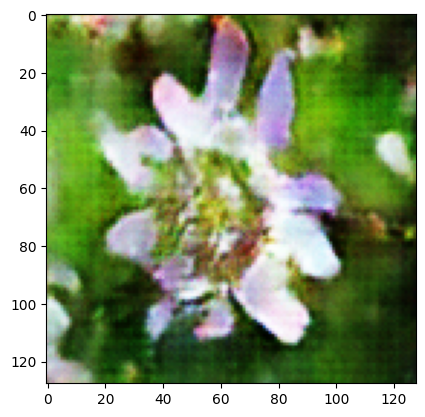

Epoch [150/1000] loss_D: 1.1803 loss_G: 1.9488 time: 9.21
Epoch [151/1000] loss_D: 1.2673 loss_G: 1.8264 time: 9.11
Epoch [152/1000] loss_D: 1.1466 loss_G: 1.9702 time: 9.06
Epoch [153/1000] loss_D: 1.5186 loss_G: 1.7708 time: 9.07
Epoch [154/1000] loss_D: 1.3716 loss_G: 1.3930 time: 9.07
Epoch [155/1000] loss_D: 1.3995 loss_G: 1.3635 time: 9.07
Epoch [156/1000] loss_D: 1.3572 loss_G: 1.4750 time: 9.06
Epoch [157/1000] loss_D: 1.3388 loss_G: 1.5512 time: 9.19
Epoch [158/1000] loss_D: 1.3161 loss_G: 1.6651 time: 9.00
Epoch [159/1000] loss_D: 1.2051 loss_G: 1.7019 time: 9.01


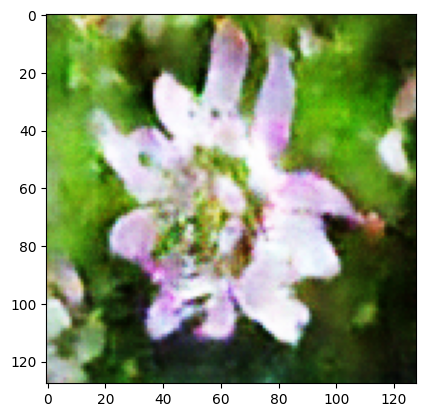

Epoch [160/1000] loss_D: 1.2870 loss_G: 1.7627 time: 9.11
Epoch [161/1000] loss_D: 1.2032 loss_G: 1.8376 time: 9.02
Epoch [162/1000] loss_D: 1.2009 loss_G: 1.8876 time: 8.99
Epoch [163/1000] loss_D: 1.3816 loss_G: 1.7745 time: 8.99
Epoch [164/1000] loss_D: 1.2045 loss_G: 1.7428 time: 9.01
Epoch [165/1000] loss_D: 1.2129 loss_G: 1.8696 time: 8.99
Epoch [166/1000] loss_D: 1.2024 loss_G: 1.8872 time: 8.99
Epoch [167/1000] loss_D: 1.2256 loss_G: 1.9795 time: 9.00
Epoch [168/1000] loss_D: 1.1681 loss_G: 1.7947 time: 9.01
Epoch [169/1000] loss_D: 1.2095 loss_G: 1.9353 time: 9.00


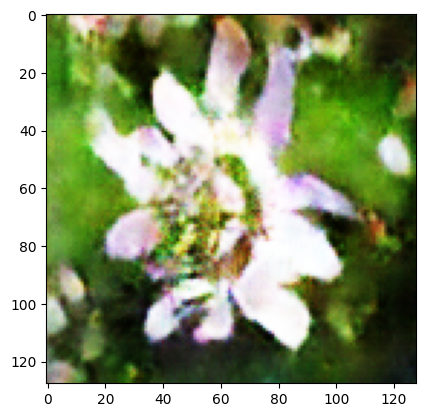

Epoch [170/1000] loss_D: 1.2048 loss_G: 1.9250 time: 9.13
Epoch [171/1000] loss_D: 1.1941 loss_G: 1.9692 time: 9.06
Epoch [172/1000] loss_D: 1.1927 loss_G: 1.9122 time: 9.19
Epoch [173/1000] loss_D: 1.1796 loss_G: 1.9562 time: 9.30
Epoch [174/1000] loss_D: 1.1334 loss_G: 2.1048 time: 9.08
Epoch [175/1000] loss_D: 1.2103 loss_G: 1.9323 time: 9.06
Epoch [176/1000] loss_D: 1.1212 loss_G: 2.0739 time: 9.15
Epoch [177/1000] loss_D: 1.1727 loss_G: 2.0160 time: 9.29
Epoch [178/1000] loss_D: 1.1914 loss_G: 1.9058 time: 9.11
Epoch [179/1000] loss_D: 1.2129 loss_G: 1.9309 time: 9.31


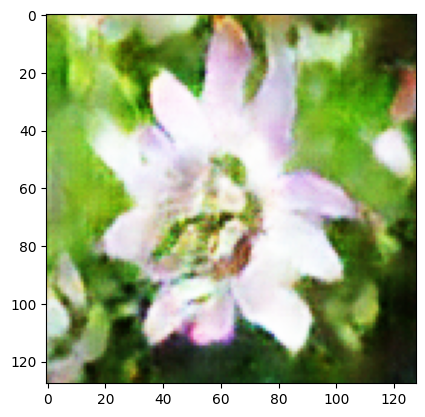

Epoch [180/1000] loss_D: 1.2030 loss_G: 1.9728 time: 11.30
Epoch [181/1000] loss_D: 1.1679 loss_G: 1.9034 time: 11.31
Epoch [182/1000] loss_D: 1.3056 loss_G: 1.7651 time: 11.22
Epoch [183/1000] loss_D: 1.1586 loss_G: 1.9863 time: 11.29
Epoch [184/1000] loss_D: 1.1026 loss_G: 2.0724 time: 11.22
Epoch [185/1000] loss_D: 1.2847 loss_G: 1.8171 time: 11.45
Epoch [186/1000] loss_D: 1.2173 loss_G: 1.9479 time: 11.34
Epoch [187/1000] loss_D: 1.1111 loss_G: 2.0758 time: 11.29
Epoch [188/1000] loss_D: 1.1016 loss_G: 2.1624 time: 11.26
Epoch [189/1000] loss_D: 1.1194 loss_G: 2.0843 time: 11.28


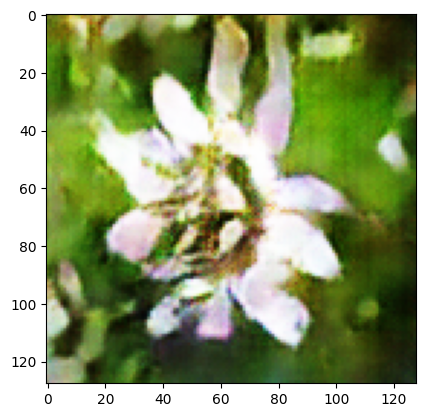

Epoch [190/1000] loss_D: 1.2118 loss_G: 1.8725 time: 11.51
Epoch [191/1000] loss_D: 1.3280 loss_G: 1.8317 time: 11.26
Epoch [192/1000] loss_D: 1.1765 loss_G: 1.7925 time: 11.29
Epoch [193/1000] loss_D: 1.1665 loss_G: 1.8981 time: 11.30
Epoch [194/1000] loss_D: 1.1870 loss_G: 1.9349 time: 11.24
Epoch [195/1000] loss_D: 1.2901 loss_G: 1.8003 time: 11.29
Epoch [196/1000] loss_D: 1.2459 loss_G: 1.7309 time: 11.24
Epoch [197/1000] loss_D: 1.1934 loss_G: 1.8860 time: 11.66
Epoch [198/1000] loss_D: 1.1976 loss_G: 1.9121 time: 11.27
Epoch [199/1000] loss_D: 1.1845 loss_G: 1.9580 time: 11.32


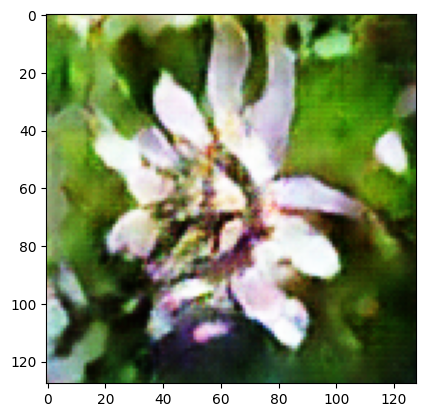

Epoch [200/1000] loss_D: 1.1407 loss_G: 1.9576 time: 11.56
Epoch [201/1000] loss_D: 1.2013 loss_G: 1.9214 time: 11.31
Epoch [202/1000] loss_D: 1.2180 loss_G: 1.8412 time: 11.28
Epoch [203/1000] loss_D: 1.1544 loss_G: 1.9300 time: 11.22
Epoch [204/1000] loss_D: 1.3448 loss_G: 1.7347 time: 11.38
Epoch [205/1000] loss_D: 1.1966 loss_G: 1.8419 time: 11.25
Epoch [206/1000] loss_D: 1.1810 loss_G: 1.9303 time: 11.47
Epoch [207/1000] loss_D: 1.2421 loss_G: 1.8880 time: 11.25
Epoch [208/1000] loss_D: 1.1559 loss_G: 1.8737 time: 11.53
Epoch [209/1000] loss_D: 1.1458 loss_G: 2.0275 time: 9.33


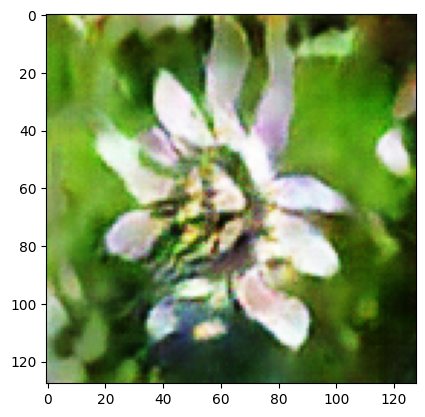

Epoch [210/1000] loss_D: 1.2125 loss_G: 1.8679 time: 9.35
Epoch [211/1000] loss_D: 1.2066 loss_G: 1.8974 time: 9.16
Epoch [212/1000] loss_D: 1.1640 loss_G: 1.9649 time: 10.07
Epoch [213/1000] loss_D: 1.1591 loss_G: 1.9521 time: 11.93
Epoch [214/1000] loss_D: 1.1541 loss_G: 1.9823 time: 11.58
Epoch [215/1000] loss_D: 1.2473 loss_G: 1.8650 time: 11.51
Epoch [216/1000] loss_D: 1.2104 loss_G: 1.8128 time: 11.41
Epoch [217/1000] loss_D: 1.2015 loss_G: 1.8960 time: 11.55
Epoch [218/1000] loss_D: 1.0835 loss_G: 2.1964 time: 11.62
Epoch [219/1000] loss_D: 1.1708 loss_G: 1.9555 time: 11.69


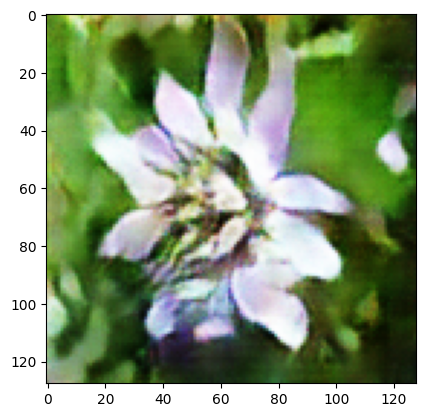

Epoch [220/1000] loss_D: 1.1966 loss_G: 1.9407 time: 11.78
Epoch [221/1000] loss_D: 1.1634 loss_G: 1.9159 time: 11.54
Epoch [222/1000] loss_D: 1.1712 loss_G: 1.9315 time: 11.53
Epoch [223/1000] loss_D: 1.3939 loss_G: 1.8230 time: 11.63
Epoch [224/1000] loss_D: 1.3054 loss_G: 1.5931 time: 11.52
Epoch [225/1000] loss_D: 1.1747 loss_G: 1.7937 time: 11.54
Epoch [226/1000] loss_D: 1.1992 loss_G: 1.8717 time: 11.51
Epoch [227/1000] loss_D: 1.2453 loss_G: 1.8324 time: 11.65
Epoch [228/1000] loss_D: 1.1870 loss_G: 1.8889 time: 11.44
Epoch [229/1000] loss_D: 1.1429 loss_G: 1.9714 time: 11.59


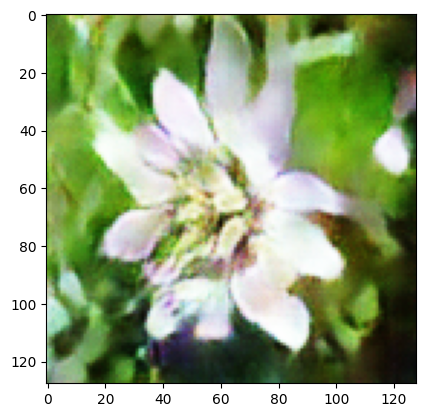

Epoch [230/1000] loss_D: 1.2251 loss_G: 1.8636 time: 11.94
Epoch [231/1000] loss_D: 1.1582 loss_G: 1.9556 time: 11.57
Epoch [232/1000] loss_D: 1.1640 loss_G: 2.0011 time: 11.53
Epoch [233/1000] loss_D: 1.1182 loss_G: 2.0528 time: 11.61
Epoch [234/1000] loss_D: 1.1240 loss_G: 2.0692 time: 11.59
Epoch [235/1000] loss_D: 1.1432 loss_G: 2.0505 time: 11.83
Epoch [236/1000] loss_D: 1.2305 loss_G: 1.8433 time: 11.57
Epoch [237/1000] loss_D: 1.1431 loss_G: 2.0021 time: 11.83
Epoch [238/1000] loss_D: 1.1888 loss_G: 1.8926 time: 11.77
Epoch [239/1000] loss_D: 1.1369 loss_G: 2.0291 time: 11.53


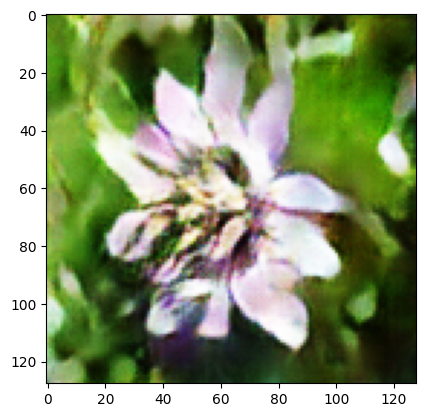

Epoch [240/1000] loss_D: 1.1695 loss_G: 2.0114 time: 11.74
Epoch [241/1000] loss_D: 1.0973 loss_G: 2.0733 time: 11.55
Epoch [242/1000] loss_D: 1.1959 loss_G: 1.9775 time: 11.37
Epoch [243/1000] loss_D: 1.1398 loss_G: 2.1644 time: 11.66
Epoch [244/1000] loss_D: 1.1795 loss_G: 1.9107 time: 11.73
Epoch [245/1000] loss_D: 1.1695 loss_G: 2.0012 time: 11.86
Epoch [246/1000] loss_D: 1.1564 loss_G: 1.9698 time: 11.71
Epoch [247/1000] loss_D: 1.0926 loss_G: 2.0995 time: 9.95
Epoch [248/1000] loss_D: 1.3326 loss_G: 1.8152 time: 9.51
Epoch [249/1000] loss_D: 1.1626 loss_G: 1.8887 time: 11.33


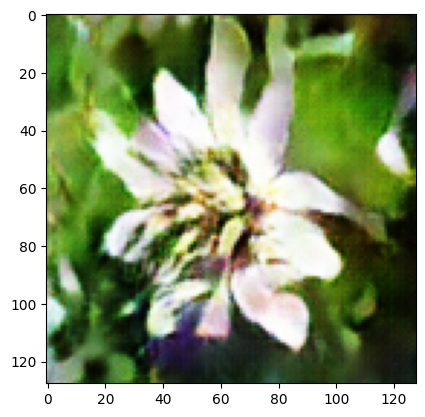

Epoch [250/1000] loss_D: 1.0883 loss_G: 2.2184 time: 10.10
Epoch [251/1000] loss_D: 1.2245 loss_G: 1.8731 time: 11.38
Epoch [252/1000] loss_D: 1.1567 loss_G: 2.0475 time: 11.37
Epoch [253/1000] loss_D: 1.2191 loss_G: 1.7680 time: 11.35
Epoch [254/1000] loss_D: 1.1384 loss_G: 2.0120 time: 11.22
Epoch [255/1000] loss_D: 1.2475 loss_G: 1.8147 time: 11.33
Epoch [256/1000] loss_D: 1.1565 loss_G: 1.9698 time: 11.38
Epoch [257/1000] loss_D: 1.1463 loss_G: 2.1047 time: 11.38
Epoch [258/1000] loss_D: 1.1389 loss_G: 1.9799 time: 11.32
Epoch [259/1000] loss_D: 1.2269 loss_G: 1.9115 time: 11.25


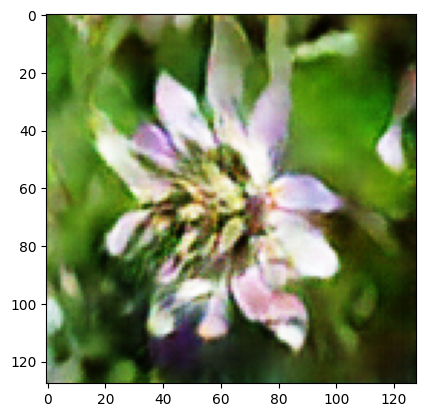

Epoch [260/1000] loss_D: 1.1462 loss_G: 1.9402 time: 11.54
Epoch [261/1000] loss_D: 1.1369 loss_G: 2.0771 time: 11.45
Epoch [262/1000] loss_D: 1.0810 loss_G: 2.1656 time: 11.40
Epoch [263/1000] loss_D: 1.5037 loss_G: 1.8773 time: 11.62
Epoch [264/1000] loss_D: 1.2291 loss_G: 1.6585 time: 11.98
Epoch [265/1000] loss_D: 1.1803 loss_G: 1.8489 time: 11.49
Epoch [266/1000] loss_D: 1.1774 loss_G: 1.9109 time: 10.82
Epoch [267/1000] loss_D: 1.1968 loss_G: 2.0859 time: 10.87
Epoch [268/1000] loss_D: 1.0318 loss_G: 2.4664 time: 11.42
Epoch [269/1000] loss_D: 1.1425 loss_G: 2.4360 time: 11.61


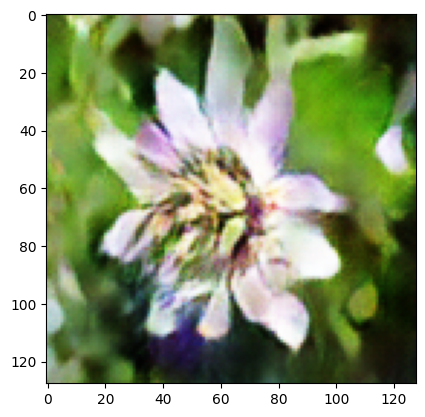

Epoch [270/1000] loss_D: 1.3274 loss_G: 1.6906 time: 11.65
Epoch [271/1000] loss_D: 1.1715 loss_G: 1.8068 time: 11.41
Epoch [272/1000] loss_D: 1.1708 loss_G: 1.9017 time: 11.42
Epoch [273/1000] loss_D: 1.1332 loss_G: 1.9404 time: 11.41
Epoch [274/1000] loss_D: 1.1448 loss_G: 1.9630 time: 11.41
Epoch [275/1000] loss_D: 1.1237 loss_G: 2.0066 time: 11.36
Epoch [276/1000] loss_D: 1.1886 loss_G: 1.9244 time: 11.40
Epoch [277/1000] loss_D: 1.1374 loss_G: 2.0559 time: 11.40
Epoch [278/1000] loss_D: 1.1066 loss_G: 2.1407 time: 11.45
Epoch [279/1000] loss_D: 1.2058 loss_G: 1.7968 time: 11.36


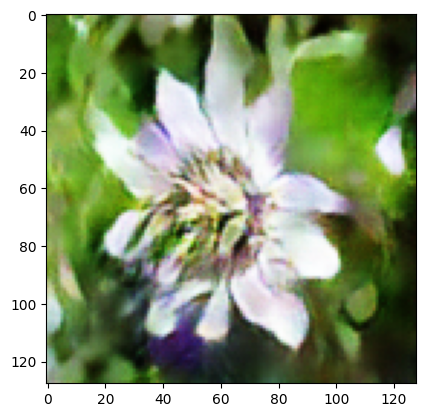

Epoch [280/1000] loss_D: 1.1924 loss_G: 1.9478 time: 9.65
Epoch [281/1000] loss_D: 1.1214 loss_G: 2.0542 time: 9.40
Epoch [282/1000] loss_D: 1.1122 loss_G: 2.3136 time: 9.28
Epoch [283/1000] loss_D: 1.1038 loss_G: 2.1369 time: 9.23
Epoch [284/1000] loss_D: 1.1933 loss_G: 2.0323 time: 9.85
Epoch [285/1000] loss_D: 1.0162 loss_G: 2.4189 time: 11.44
Epoch [286/1000] loss_D: 1.1327 loss_G: 2.1118 time: 11.36
Epoch [287/1000] loss_D: 1.1605 loss_G: 2.0673 time: 11.37
Epoch [288/1000] loss_D: 1.1062 loss_G: 2.2019 time: 11.36
Epoch [289/1000] loss_D: 1.2157 loss_G: 2.0079 time: 11.35


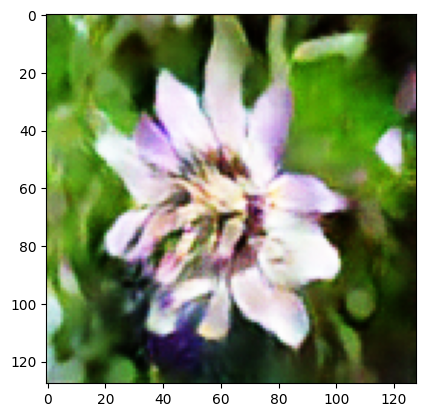

Epoch [290/1000] loss_D: 1.1476 loss_G: 1.9206 time: 11.64
Epoch [291/1000] loss_D: 1.1169 loss_G: 2.1588 time: 11.39
Epoch [292/1000] loss_D: 1.2026 loss_G: 2.2457 time: 11.32
Epoch [293/1000] loss_D: 1.1970 loss_G: 1.6994 time: 11.34
Epoch [294/1000] loss_D: 1.1400 loss_G: 1.8884 time: 11.43
Epoch [295/1000] loss_D: 1.1395 loss_G: 1.9968 time: 11.30
Epoch [296/1000] loss_D: 1.1209 loss_G: 2.1006 time: 11.30
Epoch [297/1000] loss_D: 1.1170 loss_G: 2.0328 time: 11.32
Epoch [298/1000] loss_D: 1.1567 loss_G: 2.0694 time: 11.33
Epoch [299/1000] loss_D: 1.1343 loss_G: 2.0228 time: 11.44


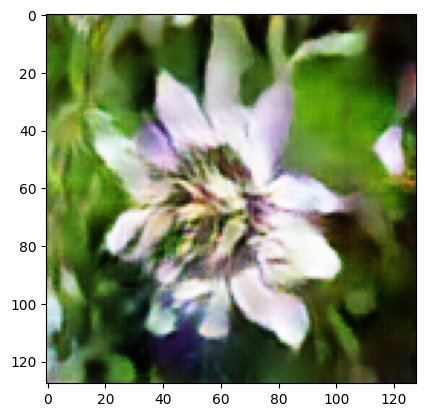

Epoch [300/1000] loss_D: 1.1246 loss_G: 2.2210 time: 11.52
Epoch [301/1000] loss_D: 1.1762 loss_G: 1.8338 time: 11.32
Epoch [302/1000] loss_D: 1.1219 loss_G: 1.9776 time: 11.45
Epoch [303/1000] loss_D: 1.1551 loss_G: 2.0890 time: 11.33
Epoch [304/1000] loss_D: 1.1481 loss_G: 2.1592 time: 11.32
Epoch [305/1000] loss_D: 1.1090 loss_G: 2.0460 time: 11.35
Epoch [306/1000] loss_D: 1.1074 loss_G: 2.2245 time: 11.32
Epoch [307/1000] loss_D: 1.0600 loss_G: 2.3582 time: 11.48
Epoch [308/1000] loss_D: 1.3456 loss_G: 1.9518 time: 11.31
Epoch [309/1000] loss_D: 1.1425 loss_G: 1.8653 time: 11.32


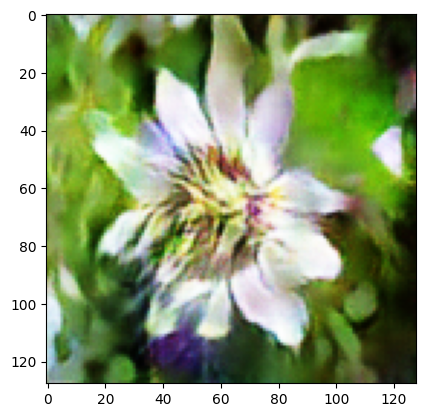

Epoch [310/1000] loss_D: 1.0925 loss_G: 2.0511 time: 11.51
Epoch [311/1000] loss_D: 1.2546 loss_G: 1.8988 time: 11.41
Epoch [312/1000] loss_D: 1.1083 loss_G: 1.9648 time: 11.28
Epoch [313/1000] loss_D: 1.1090 loss_G: 2.1766 time: 11.34
Epoch [314/1000] loss_D: 1.1735 loss_G: 2.0031 time: 11.37
Epoch [315/1000] loss_D: 1.0384 loss_G: 2.2737 time: 11.39
Epoch [316/1000] loss_D: 1.2519 loss_G: 1.9795 time: 11.36
Epoch [317/1000] loss_D: 1.1302 loss_G: 1.8816 time: 11.38
Epoch [318/1000] loss_D: 1.1163 loss_G: 2.1212 time: 11.36
Epoch [319/1000] loss_D: 1.1051 loss_G: 2.2465 time: 11.36


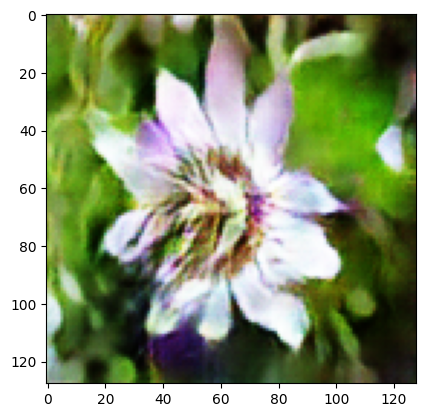

Epoch [320/1000] loss_D: 1.0438 loss_G: 2.3275 time: 11.63
Epoch [321/1000] loss_D: 1.0374 loss_G: 2.4165 time: 11.43
Epoch [322/1000] loss_D: 0.9112 loss_G: 2.8301 time: 11.38
Epoch [323/1000] loss_D: 1.4319 loss_G: 1.7872 time: 11.38
Epoch [324/1000] loss_D: 1.1658 loss_G: 1.8156 time: 11.42
Epoch [325/1000] loss_D: 1.1118 loss_G: 2.1704 time: 11.40
Epoch [326/1000] loss_D: 1.1530 loss_G: 2.1583 time: 11.29
Epoch [327/1000] loss_D: 1.1201 loss_G: 1.9716 time: 11.44
Epoch [328/1000] loss_D: 1.1341 loss_G: 2.1689 time: 11.47
Epoch [329/1000] loss_D: 1.0676 loss_G: 2.3784 time: 11.39


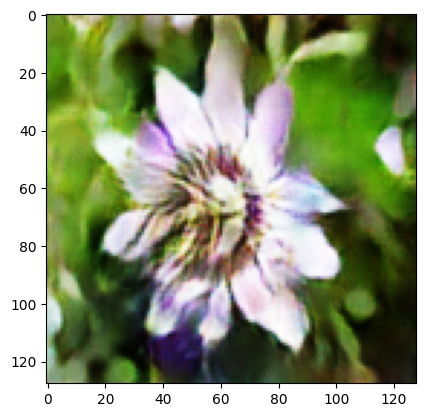

Epoch [330/1000] loss_D: 1.1654 loss_G: 2.1659 time: 10.53
Epoch [331/1000] loss_D: 1.0627 loss_G: 2.0750 time: 9.21
Epoch [332/1000] loss_D: 1.1396 loss_G: 2.1553 time: 9.34
Epoch [333/1000] loss_D: 1.0271 loss_G: 2.4291 time: 10.74
Epoch [334/1000] loss_D: 0.9412 loss_G: 2.6636 time: 10.05
Epoch [335/1000] loss_D: 1.3215 loss_G: 2.0819 time: 10.65
Epoch [336/1000] loss_D: 1.1720 loss_G: 1.8453 time: 11.35
Epoch [337/1000] loss_D: 1.1459 loss_G: 1.9260 time: 11.28
Epoch [338/1000] loss_D: 1.1391 loss_G: 2.0112 time: 11.31
Epoch [339/1000] loss_D: 1.0854 loss_G: 2.0788 time: 11.47


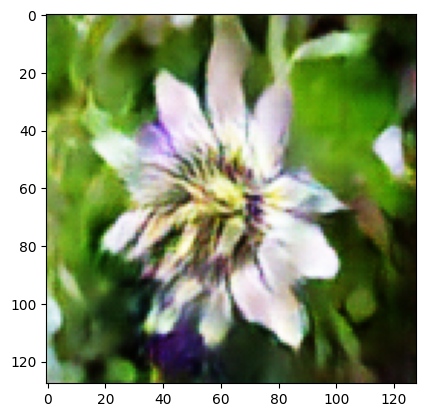

Epoch [340/1000] loss_D: 1.1450 loss_G: 2.0615 time: 11.45
Epoch [341/1000] loss_D: 1.0731 loss_G: 2.1814 time: 11.32
Epoch [342/1000] loss_D: 1.1278 loss_G: 2.0328 time: 11.32
Epoch [343/1000] loss_D: 1.2301 loss_G: 1.9671 time: 11.36
Epoch [344/1000] loss_D: 1.1066 loss_G: 2.0067 time: 11.37
Epoch [345/1000] loss_D: 1.0912 loss_G: 2.0670 time: 10.67
Epoch [346/1000] loss_D: 1.1416 loss_G: 1.9828 time: 9.24
Epoch [347/1000] loss_D: 1.0964 loss_G: 2.0758 time: 9.28
Epoch [348/1000] loss_D: 1.1216 loss_G: 2.0369 time: 9.29
Epoch [349/1000] loss_D: 1.0964 loss_G: 2.1027 time: 9.33


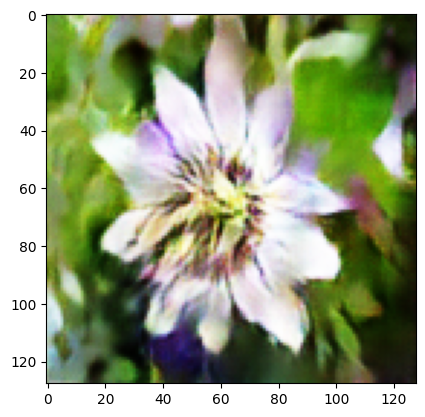

Epoch [350/1000] loss_D: 1.1285 loss_G: 2.1026 time: 9.29
Epoch [351/1000] loss_D: 1.0444 loss_G: 2.4217 time: 9.38
Epoch [352/1000] loss_D: 1.1109 loss_G: 2.1009 time: 9.11
Epoch [353/1000] loss_D: 1.1364 loss_G: 2.0430 time: 9.36
Epoch [354/1000] loss_D: 1.1773 loss_G: 1.9131 time: 9.32
Epoch [355/1000] loss_D: 1.1299 loss_G: 2.0398 time: 9.23
Epoch [356/1000] loss_D: 1.1099 loss_G: 2.0446 time: 9.26
Epoch [357/1000] loss_D: 1.1331 loss_G: 2.0702 time: 9.29
Epoch [358/1000] loss_D: 1.0665 loss_G: 2.2436 time: 9.22
Epoch [359/1000] loss_D: 1.0754 loss_G: 2.2995 time: 9.02


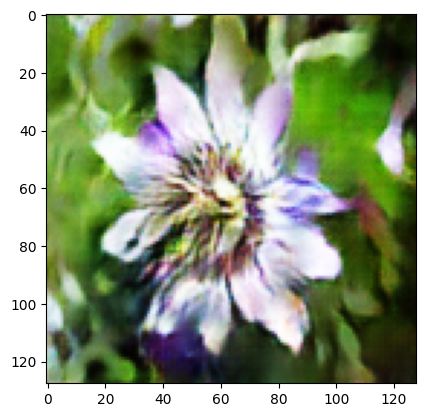

Epoch [360/1000] loss_D: 1.0664 loss_G: 2.4155 time: 9.03
Epoch [361/1000] loss_D: 1.1892 loss_G: 1.9284 time: 9.10
Epoch [362/1000] loss_D: 1.1649 loss_G: 2.1272 time: 9.11
Epoch [363/1000] loss_D: 0.9899 loss_G: 2.5480 time: 10.19
Epoch [364/1000] loss_D: 1.0812 loss_G: 2.3150 time: 11.43
Epoch [365/1000] loss_D: 1.0963 loss_G: 2.3819 time: 11.51
Epoch [366/1000] loss_D: 1.0055 loss_G: 2.4922 time: 10.73
Epoch [367/1000] loss_D: 1.0400 loss_G: 2.4714 time: 9.18
Epoch [368/1000] loss_D: 0.8689 loss_G: 3.1265 time: 9.21
Epoch [369/1000] loss_D: 1.1840 loss_G: 2.4076 time: 9.17


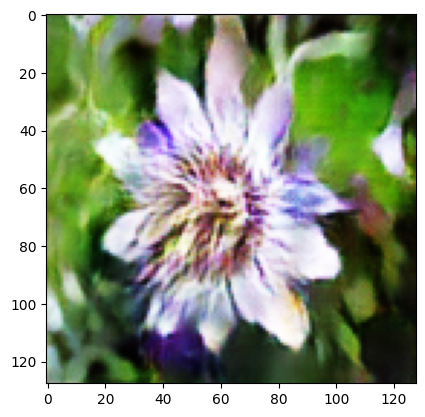

Epoch [370/1000] loss_D: 0.9969 loss_G: 2.4751 time: 9.57
Epoch [371/1000] loss_D: 1.2394 loss_G: 2.0437 time: 11.44
Epoch [372/1000] loss_D: 1.0620 loss_G: 2.2686 time: 11.44
Epoch [373/1000] loss_D: 0.9305 loss_G: 2.7020 time: 11.35
Epoch [374/1000] loss_D: 1.0282 loss_G: 2.5514 time: 11.33
Epoch [375/1000] loss_D: 1.0019 loss_G: 2.6069 time: 11.45
Epoch [376/1000] loss_D: 0.9789 loss_G: 2.7420 time: 11.39
Epoch [377/1000] loss_D: 0.8689 loss_G: 3.0566 time: 11.31
Epoch [378/1000] loss_D: 1.0139 loss_G: 2.9292 time: 11.39
Epoch [379/1000] loss_D: 0.9974 loss_G: 2.5281 time: 11.48


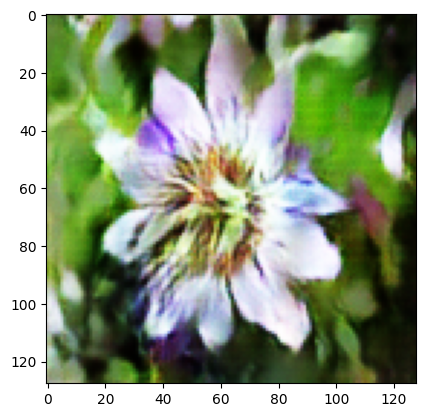

Epoch [380/1000] loss_D: 0.8748 loss_G: 2.9932 time: 11.52
Epoch [381/1000] loss_D: 1.0694 loss_G: 2.6252 time: 11.38
Epoch [382/1000] loss_D: 0.9432 loss_G: 2.8296 time: 11.36
Epoch [383/1000] loss_D: 0.9930 loss_G: 2.6089 time: 11.42
Epoch [384/1000] loss_D: 0.9075 loss_G: 3.0895 time: 11.30
Epoch [385/1000] loss_D: 0.9257 loss_G: 3.1710 time: 11.34
Epoch [386/1000] loss_D: 1.0524 loss_G: 2.3521 time: 11.35
Epoch [387/1000] loss_D: 1.0883 loss_G: 2.5505 time: 11.48
Epoch [388/1000] loss_D: 1.0968 loss_G: 2.3874 time: 11.48
Epoch [389/1000] loss_D: 1.0153 loss_G: 2.3904 time: 9.36


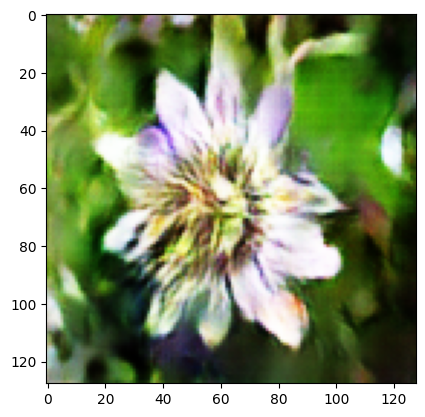

Epoch [390/1000] loss_D: 1.0076 loss_G: 2.5752 time: 9.46
Epoch [391/1000] loss_D: 1.1849 loss_G: 2.5795 time: 11.34
Epoch [392/1000] loss_D: 1.2387 loss_G: 1.8825 time: 11.47
Epoch [393/1000] loss_D: 1.0099 loss_G: 2.4649 time: 11.12
Epoch [394/1000] loss_D: 1.0789 loss_G: 2.3916 time: 11.04
Epoch [395/1000] loss_D: 0.9516 loss_G: 2.6521 time: 11.44
Epoch [396/1000] loss_D: 1.0114 loss_G: 2.6266 time: 11.35
Epoch [397/1000] loss_D: 0.8640 loss_G: 3.3078 time: 11.41
Epoch [398/1000] loss_D: 0.8879 loss_G: 3.0880 time: 11.42
Epoch [399/1000] loss_D: 0.8644 loss_G: 3.4789 time: 11.43


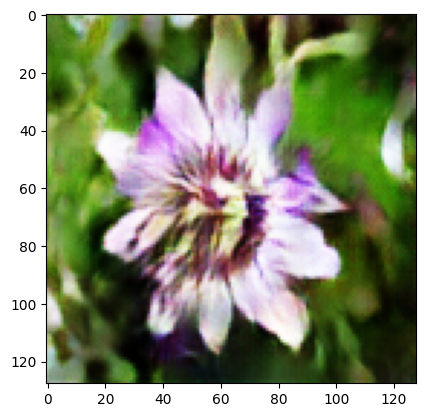

Epoch [400/1000] loss_D: 0.8738 loss_G: 3.3699 time: 11.64
Epoch [401/1000] loss_D: 0.8555 loss_G: 3.5243 time: 11.50
Epoch [402/1000] loss_D: 0.8352 loss_G: 3.5939 time: 11.40
Epoch [403/1000] loss_D: 1.4491 loss_G: 2.9738 time: 11.43
Epoch [404/1000] loss_D: 1.3604 loss_G: 1.4654 time: 11.43
Epoch [405/1000] loss_D: 1.2368 loss_G: 1.6363 time: 11.36
Epoch [406/1000] loss_D: 1.1934 loss_G: 1.8068 time: 11.33
Epoch [407/1000] loss_D: 1.2585 loss_G: 1.7006 time: 10.29
Epoch [408/1000] loss_D: 1.1325 loss_G: 1.9563 time: 9.21
Epoch [409/1000] loss_D: 1.2108 loss_G: 1.9581 time: 9.44


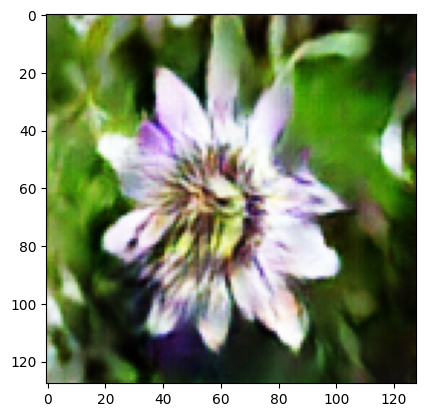

Epoch [410/1000] loss_D: 1.1439 loss_G: 2.0717 time: 9.68
Epoch [411/1000] loss_D: 1.2398 loss_G: 1.8845 time: 9.75
Epoch [412/1000] loss_D: 1.0914 loss_G: 2.1401 time: 9.46
Epoch [413/1000] loss_D: 1.1832 loss_G: 1.9463 time: 9.47
Epoch [414/1000] loss_D: 1.0436 loss_G: 2.2378 time: 9.49
Epoch [415/1000] loss_D: 1.1609 loss_G: 2.1881 time: 9.54
Epoch [416/1000] loss_D: 1.0471 loss_G: 2.3318 time: 9.51
Epoch [417/1000] loss_D: 0.9755 loss_G: 2.7269 time: 9.52
Epoch [418/1000] loss_D: 0.9878 loss_G: 2.6333 time: 9.53
Epoch [419/1000] loss_D: 0.9324 loss_G: 2.8146 time: 9.47


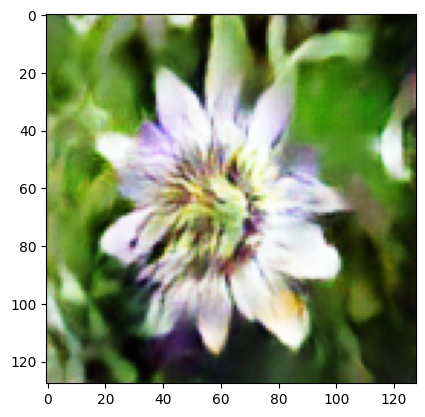

Epoch [420/1000] loss_D: 1.0049 loss_G: 2.8663 time: 9.54
Epoch [421/1000] loss_D: 1.2398 loss_G: 1.7049 time: 9.54
Epoch [422/1000] loss_D: 1.1420 loss_G: 1.8861 time: 9.64
Epoch [423/1000] loss_D: 1.1454 loss_G: 1.9018 time: 9.53
Epoch [424/1000] loss_D: 1.1800 loss_G: 1.9677 time: 9.63
Epoch [425/1000] loss_D: 1.1245 loss_G: 1.9601 time: 9.66
Epoch [426/1000] loss_D: 1.2150 loss_G: 2.0490 time: 9.34
Epoch [427/1000] loss_D: 1.1406 loss_G: 1.8430 time: 9.99
Epoch [428/1000] loss_D: 1.1748 loss_G: 2.0207 time: 11.09
Epoch [429/1000] loss_D: 1.1142 loss_G: 1.9400 time: 11.12


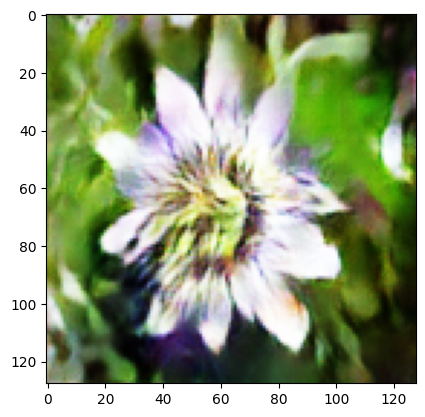

Epoch [430/1000] loss_D: 1.1536 loss_G: 1.9209 time: 11.24
Epoch [431/1000] loss_D: 1.1663 loss_G: 1.9450 time: 11.15
Epoch [432/1000] loss_D: 1.1448 loss_G: 1.9808 time: 11.14
Epoch [433/1000] loss_D: 1.1926 loss_G: 1.9734 time: 11.10
Epoch [434/1000] loss_D: 1.1105 loss_G: 1.9753 time: 11.11
Epoch [435/1000] loss_D: 1.1041 loss_G: 2.0418 time: 11.07
Epoch [436/1000] loss_D: 1.0075 loss_G: 2.7752 time: 11.02
Epoch [437/1000] loss_D: 1.1048 loss_G: 2.3269 time: 11.11
Epoch [438/1000] loss_D: 1.0373 loss_G: 2.4119 time: 11.07
Epoch [439/1000] loss_D: 1.1208 loss_G: 2.1301 time: 11.10


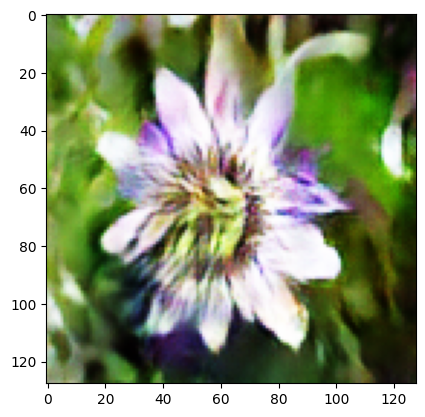

Epoch [440/1000] loss_D: 1.1417 loss_G: 2.1354 time: 11.29
Epoch [441/1000] loss_D: 1.0919 loss_G: 2.1130 time: 11.07
Epoch [442/1000] loss_D: 1.1240 loss_G: 2.0842 time: 10.64
Epoch [443/1000] loss_D: 1.1258 loss_G: 2.0714 time: 11.04
Epoch [444/1000] loss_D: 1.0715 loss_G: 2.1573 time: 11.45
Epoch [445/1000] loss_D: 1.1167 loss_G: 2.0641 time: 11.35
Epoch [446/1000] loss_D: 1.2870 loss_G: 1.9813 time: 11.31
Epoch [447/1000] loss_D: 1.1171 loss_G: 1.9517 time: 11.42
Epoch [448/1000] loss_D: 1.1139 loss_G: 2.0047 time: 11.37
Epoch [449/1000] loss_D: 1.1477 loss_G: 2.0400 time: 11.34


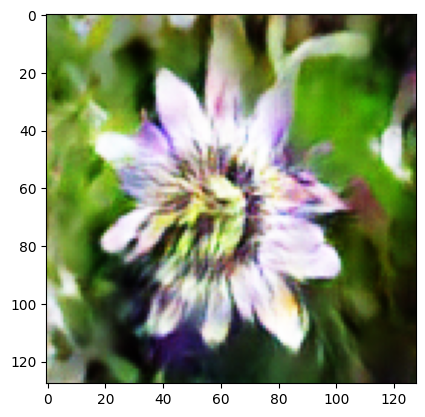

Epoch [450/1000] loss_D: 1.0575 loss_G: 2.1602 time: 11.60
Epoch [451/1000] loss_D: 1.0831 loss_G: 2.2397 time: 11.51
Epoch [452/1000] loss_D: 1.1140 loss_G: 2.0200 time: 11.38
Epoch [453/1000] loss_D: 1.1244 loss_G: 2.1167 time: 11.45
Epoch [454/1000] loss_D: 1.1010 loss_G: 2.0612 time: 11.38
Epoch [455/1000] loss_D: 1.1048 loss_G: 2.0807 time: 11.40
Epoch [456/1000] loss_D: 1.1293 loss_G: 2.0610 time: 11.43
Epoch [457/1000] loss_D: 1.0867 loss_G: 2.1127 time: 11.40
Epoch [458/1000] loss_D: 1.1315 loss_G: 2.1023 time: 11.43
Epoch [459/1000] loss_D: 1.0900 loss_G: 2.0693 time: 11.45


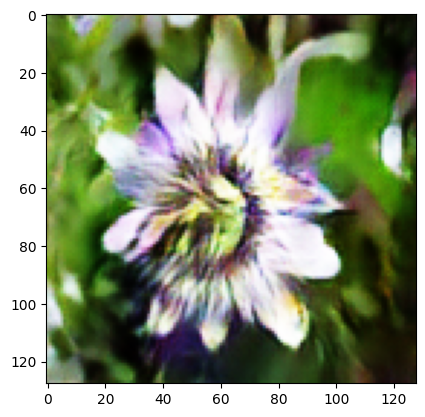

Epoch [460/1000] loss_D: 1.1342 loss_G: 2.1170 time: 11.67
Epoch [461/1000] loss_D: 1.1990 loss_G: 2.1382 time: 10.46
Epoch [462/1000] loss_D: 1.1504 loss_G: 1.7994 time: 9.23
Epoch [463/1000] loss_D: 1.1885 loss_G: 1.9334 time: 9.80
Epoch [464/1000] loss_D: 1.0937 loss_G: 2.0573 time: 11.86
Epoch [465/1000] loss_D: 1.1637 loss_G: 2.1244 time: 12.06
Epoch [466/1000] loss_D: 1.0366 loss_G: 2.2237 time: 12.05
Epoch [467/1000] loss_D: 1.0955 loss_G: 2.1169 time: 11.99
Epoch [468/1000] loss_D: 1.1172 loss_G: 2.1050 time: 11.92
Epoch [469/1000] loss_D: 1.1511 loss_G: 2.0099 time: 11.33


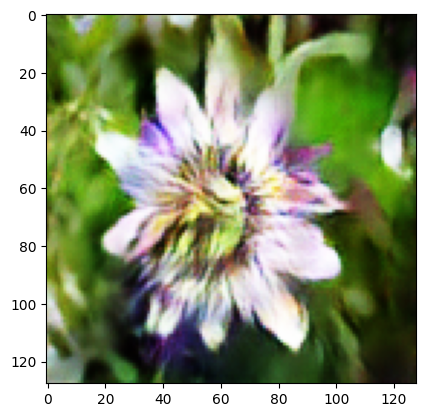

Epoch [470/1000] loss_D: 1.0830 loss_G: 2.0994 time: 11.15
Epoch [471/1000] loss_D: 1.0773 loss_G: 2.1082 time: 11.10
Epoch [472/1000] loss_D: 1.1306 loss_G: 2.1328 time: 10.99
Epoch [473/1000] loss_D: 1.0671 loss_G: 2.1814 time: 11.07
Epoch [474/1000] loss_D: 1.1234 loss_G: 2.0399 time: 10.52
Epoch [475/1000] loss_D: 1.0857 loss_G: 2.2564 time: 10.46
Epoch [476/1000] loss_D: 1.0634 loss_G: 2.2192 time: 11.36
Epoch [477/1000] loss_D: 1.2218 loss_G: 2.0645 time: 11.03
Epoch [478/1000] loss_D: 1.0925 loss_G: 2.0975 time: 11.13
Epoch [479/1000] loss_D: 1.1030 loss_G: 2.0128 time: 11.02


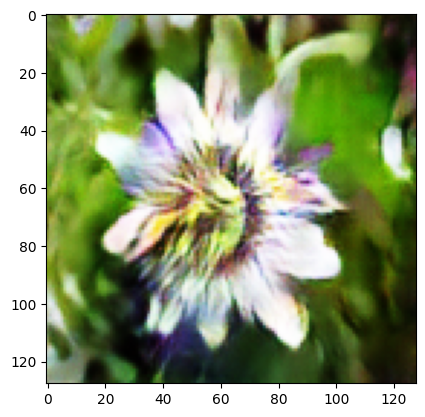

Epoch [480/1000] loss_D: 1.0978 loss_G: 2.1010 time: 11.26
Epoch [481/1000] loss_D: 1.0626 loss_G: 2.1787 time: 11.01
Epoch [482/1000] loss_D: 1.0938 loss_G: 2.1537 time: 11.09
Epoch [483/1000] loss_D: 1.1089 loss_G: 2.1569 time: 11.10
Epoch [484/1000] loss_D: 1.0588 loss_G: 2.2228 time: 11.05
Epoch [485/1000] loss_D: 1.1559 loss_G: 2.0102 time: 11.31
Epoch [486/1000] loss_D: 1.1271 loss_G: 2.0937 time: 11.14
Epoch [487/1000] loss_D: 1.0769 loss_G: 2.2065 time: 11.04
Epoch [488/1000] loss_D: 1.0135 loss_G: 2.4820 time: 11.04
Epoch [489/1000] loss_D: 1.0129 loss_G: 2.6331 time: 11.05


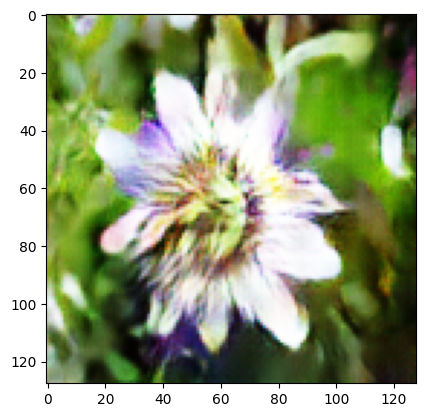

Epoch [490/1000] loss_D: 0.9844 loss_G: 2.8752 time: 11.46
Epoch [491/1000] loss_D: 0.9367 loss_G: 2.9713 time: 11.29
Epoch [492/1000] loss_D: 0.9218 loss_G: 3.1209 time: 11.07
Epoch [493/1000] loss_D: 1.0681 loss_G: 2.4372 time: 10.94
Epoch [494/1000] loss_D: 1.0784 loss_G: 1.9919 time: 10.91
Epoch [495/1000] loss_D: 1.1499 loss_G: 2.0982 time: 11.02
Epoch [496/1000] loss_D: 1.0925 loss_G: 2.1476 time: 11.07
Epoch [497/1000] loss_D: 1.1578 loss_G: 2.2799 time: 10.98
Epoch [498/1000] loss_D: 1.1274 loss_G: 1.9313 time: 10.95
Epoch [499/1000] loss_D: 1.0044 loss_G: 2.3901 time: 10.93


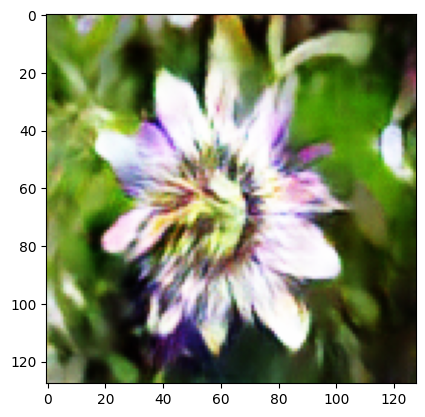

Epoch [500/1000] loss_D: 0.9799 loss_G: 2.7672 time: 11.05
Epoch [501/1000] loss_D: 0.9014 loss_G: 2.9559 time: 11.03
Epoch [502/1000] loss_D: 0.9149 loss_G: 2.9262 time: 10.93
Epoch [503/1000] loss_D: 1.6074 loss_G: 1.9516 time: 10.98
Epoch [504/1000] loss_D: 1.2037 loss_G: 1.8260 time: 10.98
Epoch [505/1000] loss_D: 0.9650 loss_G: 2.7718 time: 10.88
Epoch [506/1000] loss_D: 0.8746 loss_G: 3.3103 time: 10.92
Epoch [507/1000] loss_D: 0.8132 loss_G: 3.9140 time: 10.94
Epoch [508/1000] loss_D: 0.9161 loss_G: 3.1889 time: 10.93
Epoch [509/1000] loss_D: 0.9666 loss_G: 2.8242 time: 10.92


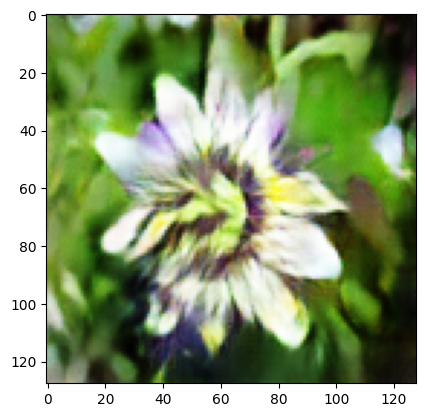

Epoch [510/1000] loss_D: 0.9032 loss_G: 2.9647 time: 11.07
Epoch [511/1000] loss_D: 0.8758 loss_G: 3.1168 time: 10.88
Epoch [512/1000] loss_D: 0.9023 loss_G: 3.0987 time: 10.90
Epoch [513/1000] loss_D: 0.8520 loss_G: 3.1432 time: 10.92
Epoch [514/1000] loss_D: 0.8558 loss_G: 3.3507 time: 10.92
Epoch [515/1000] loss_D: 0.9714 loss_G: 2.9117 time: 11.03
Epoch [516/1000] loss_D: 0.8994 loss_G: 3.0537 time: 10.95
Epoch [517/1000] loss_D: 0.8436 loss_G: 3.2388 time: 10.87
Epoch [518/1000] loss_D: 0.9860 loss_G: 2.8424 time: 10.83
Epoch [519/1000] loss_D: 0.8824 loss_G: 2.9791 time: 10.74


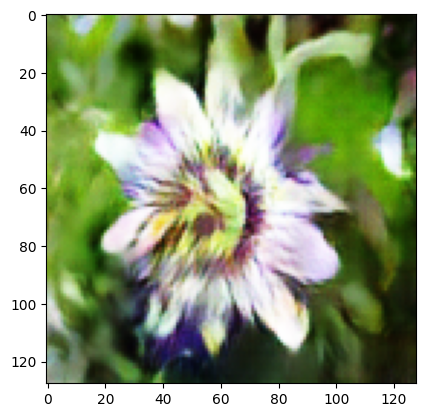

Epoch [520/1000] loss_D: 1.1078 loss_G: 2.6826 time: 9.73
Epoch [521/1000] loss_D: 0.9457 loss_G: 2.5379 time: 9.17
Epoch [522/1000] loss_D: 0.9862 loss_G: 2.5426 time: 9.15
Epoch [523/1000] loss_D: 0.9414 loss_G: 2.7188 time: 9.09
Epoch [524/1000] loss_D: 1.0233 loss_G: 2.6400 time: 9.17
Epoch [525/1000] loss_D: 0.9815 loss_G: 2.6956 time: 9.13
Epoch [526/1000] loss_D: 0.9692 loss_G: 2.6141 time: 9.11
Epoch [527/1000] loss_D: 0.9301 loss_G: 2.8108 time: 9.09
Epoch [528/1000] loss_D: 0.8567 loss_G: 3.0945 time: 9.25
Epoch [529/1000] loss_D: 0.8673 loss_G: 3.3414 time: 9.10


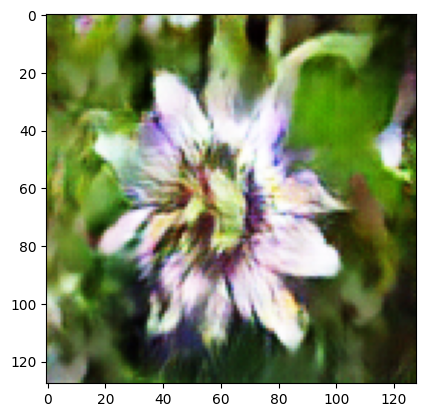

Epoch [530/1000] loss_D: 0.8190 loss_G: 3.5614 time: 10.36
Epoch [531/1000] loss_D: 0.8014 loss_G: 3.8532 time: 11.28
Epoch [532/1000] loss_D: 0.7884 loss_G: 3.7529 time: 11.13
Epoch [533/1000] loss_D: 0.8423 loss_G: 3.5529 time: 11.13
Epoch [534/1000] loss_D: 0.8522 loss_G: 3.5579 time: 11.20
Epoch [535/1000] loss_D: 0.8074 loss_G: 3.5447 time: 11.27
Epoch [536/1000] loss_D: 0.8304 loss_G: 3.7327 time: 11.21
Epoch [537/1000] loss_D: 0.8012 loss_G: 3.5983 time: 11.21
Epoch [538/1000] loss_D: 0.8046 loss_G: 3.7775 time: 11.26
Epoch [539/1000] loss_D: 1.1224 loss_G: 2.4326 time: 11.21


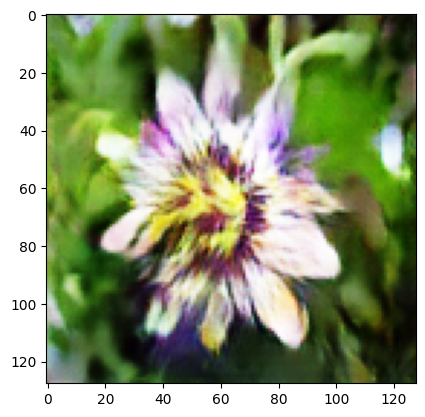

Epoch [540/1000] loss_D: 0.8629 loss_G: 3.0888 time: 11.36
Epoch [541/1000] loss_D: 1.0815 loss_G: 2.6839 time: 11.01
Epoch [542/1000] loss_D: 0.8728 loss_G: 3.0473 time: 9.10
Epoch [543/1000] loss_D: 1.1350 loss_G: 2.5051 time: 10.04
Epoch [544/1000] loss_D: 0.9220 loss_G: 2.7744 time: 10.89
Epoch [545/1000] loss_D: 0.9607 loss_G: 2.8479 time: 10.87
Epoch [546/1000] loss_D: 0.8511 loss_G: 3.1765 time: 11.17
Epoch [547/1000] loss_D: 1.1204 loss_G: 2.5282 time: 11.10
Epoch [548/1000] loss_D: 0.9689 loss_G: 2.5771 time: 10.93
Epoch [549/1000] loss_D: 0.8703 loss_G: 3.1350 time: 10.88


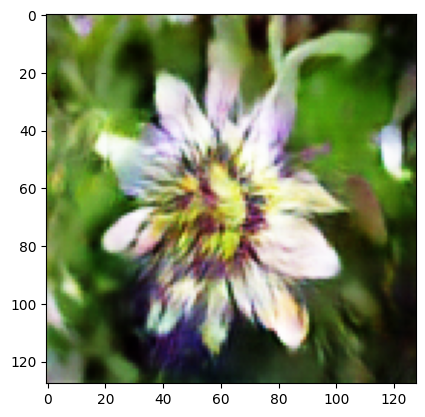

Epoch [550/1000] loss_D: 1.0113 loss_G: 2.9398 time: 11.08
Epoch [551/1000] loss_D: 1.1398 loss_G: 2.0095 time: 10.91
Epoch [552/1000] loss_D: 0.9929 loss_G: 2.6871 time: 10.94
Epoch [553/1000] loss_D: 1.1258 loss_G: 2.2690 time: 10.88
Epoch [554/1000] loss_D: 1.1657 loss_G: 2.0252 time: 10.86
Epoch [555/1000] loss_D: 1.1914 loss_G: 1.9025 time: 10.88
Epoch [556/1000] loss_D: 1.0309 loss_G: 2.5722 time: 10.89
Epoch [557/1000] loss_D: 1.0295 loss_G: 2.3317 time: 10.96
Epoch [558/1000] loss_D: 0.8795 loss_G: 2.9887 time: 10.87
Epoch [559/1000] loss_D: 0.8883 loss_G: 3.1165 time: 10.89


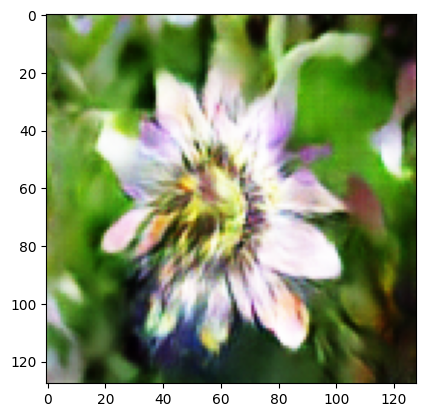

Epoch [560/1000] loss_D: 0.8616 loss_G: 3.0637 time: 11.30
Epoch [561/1000] loss_D: 1.0612 loss_G: 2.9764 time: 9.23
Epoch [562/1000] loss_D: 1.1114 loss_G: 2.0085 time: 9.08
Epoch [563/1000] loss_D: 1.0134 loss_G: 2.5150 time: 10.46
Epoch [564/1000] loss_D: 0.9521 loss_G: 2.6849 time: 10.99
Epoch [565/1000] loss_D: 0.9322 loss_G: 2.8515 time: 10.90
Epoch [566/1000] loss_D: 0.9990 loss_G: 2.6450 time: 10.85
Epoch [567/1000] loss_D: 0.9394 loss_G: 2.8619 time: 10.83
Epoch [568/1000] loss_D: 0.8913 loss_G: 2.9844 time: 10.83
Epoch [569/1000] loss_D: 0.9111 loss_G: 3.0354 time: 11.00


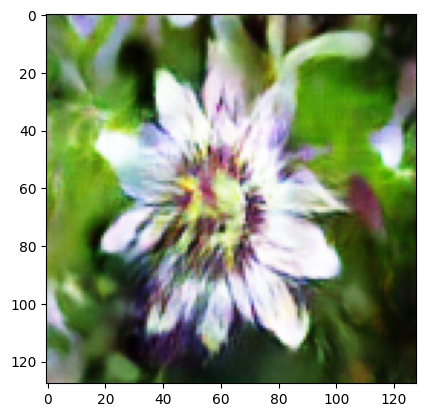

Epoch [570/1000] loss_D: 0.9706 loss_G: 2.7781 time: 11.04
Epoch [571/1000] loss_D: 0.9079 loss_G: 2.9005 time: 10.90
Epoch [572/1000] loss_D: 1.0103 loss_G: 2.8892 time: 10.91
Epoch [573/1000] loss_D: 0.9780 loss_G: 2.4168 time: 10.87
Epoch [574/1000] loss_D: 0.9389 loss_G: 2.9082 time: 10.88
Epoch [575/1000] loss_D: 0.8805 loss_G: 3.0063 time: 11.07
Epoch [576/1000] loss_D: 0.8963 loss_G: 3.0669 time: 9.47
Epoch [577/1000] loss_D: 1.0074 loss_G: 2.8527 time: 9.19
Epoch [578/1000] loss_D: 1.1260 loss_G: 2.1950 time: 9.22
Epoch [579/1000] loss_D: 1.1975 loss_G: 2.2967 time: 9.24


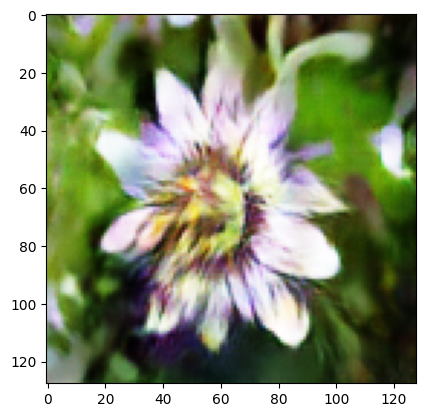

Epoch [580/1000] loss_D: 1.3311 loss_G: 1.7580 time: 9.26
Epoch [581/1000] loss_D: 1.1520 loss_G: 1.8734 time: 9.35
Epoch [582/1000] loss_D: 1.1038 loss_G: 1.9148 time: 10.38
Epoch [583/1000] loss_D: 1.0973 loss_G: 1.9885 time: 11.21
Epoch [584/1000] loss_D: 1.1554 loss_G: 1.8743 time: 11.30
Epoch [585/1000] loss_D: 1.1182 loss_G: 1.9803 time: 11.22
Epoch [586/1000] loss_D: 1.0997 loss_G: 1.9842 time: 11.32
Epoch [587/1000] loss_D: 1.2025 loss_G: 1.9058 time: 10.19
Epoch [588/1000] loss_D: 1.1020 loss_G: 1.9194 time: 9.18
Epoch [589/1000] loss_D: 1.0988 loss_G: 1.9615 time: 9.10


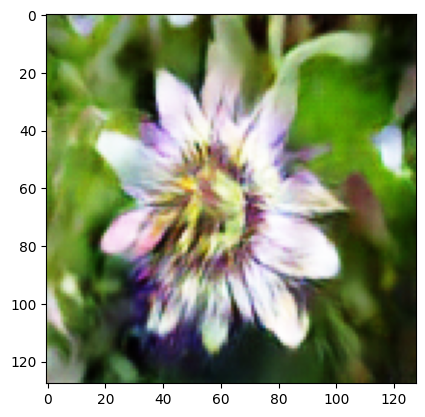

Epoch [590/1000] loss_D: 1.2243 loss_G: 1.8431 time: 9.32
Epoch [591/1000] loss_D: 1.1285 loss_G: 1.9148 time: 9.25
Epoch [592/1000] loss_D: 1.0942 loss_G: 1.9955 time: 9.15
Epoch [593/1000] loss_D: 1.1307 loss_G: 1.9940 time: 9.09
Epoch [594/1000] loss_D: 1.0671 loss_G: 2.0165 time: 9.02
Epoch [595/1000] loss_D: 1.1137 loss_G: 2.0117 time: 9.02
Epoch [596/1000] loss_D: 1.1138 loss_G: 1.9928 time: 9.01
Epoch [597/1000] loss_D: 1.0948 loss_G: 2.0004 time: 9.03
Epoch [598/1000] loss_D: 1.0823 loss_G: 2.0442 time: 9.05
Epoch [599/1000] loss_D: 1.1137 loss_G: 1.9802 time: 9.03


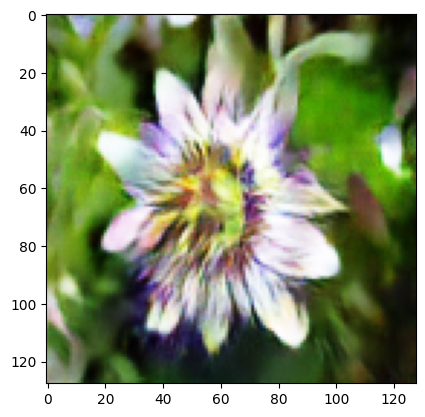

Epoch [600/1000] loss_D: 1.1000 loss_G: 2.0081 time: 9.19
Epoch [601/1000] loss_D: 1.1242 loss_G: 1.9672 time: 9.13
Epoch [602/1000] loss_D: 1.0821 loss_G: 2.0310 time: 9.03
Epoch [603/1000] loss_D: 1.1600 loss_G: 1.9421 time: 9.03
Epoch [604/1000] loss_D: 1.0848 loss_G: 2.0618 time: 9.03
Epoch [605/1000] loss_D: 1.1431 loss_G: 1.9576 time: 9.07
Epoch [606/1000] loss_D: 1.0928 loss_G: 1.9783 time: 9.05
Epoch [607/1000] loss_D: 1.2125 loss_G: 1.8961 time: 9.08
Epoch [608/1000] loss_D: 1.0670 loss_G: 2.0143 time: 9.09
Epoch [609/1000] loss_D: 1.1386 loss_G: 1.9860 time: 9.01


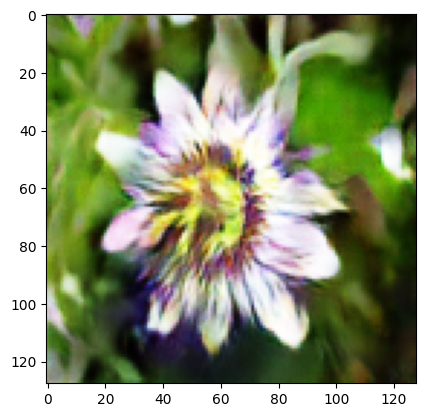

Epoch [610/1000] loss_D: 1.0917 loss_G: 2.0428 time: 9.16
Epoch [611/1000] loss_D: 1.1060 loss_G: 1.9882 time: 9.18
Epoch [612/1000] loss_D: 1.1346 loss_G: 2.0010 time: 9.05
Epoch [613/1000] loss_D: 1.0966 loss_G: 1.9828 time: 9.10
Epoch [614/1000] loss_D: 1.0690 loss_G: 2.1018 time: 9.06
Epoch [615/1000] loss_D: 1.0987 loss_G: 2.0356 time: 9.09
Epoch [616/1000] loss_D: 1.1622 loss_G: 1.9555 time: 9.09
Epoch [617/1000] loss_D: 1.0947 loss_G: 2.0210 time: 9.05
Epoch [618/1000] loss_D: 1.1083 loss_G: 2.0056 time: 9.05
Epoch [619/1000] loss_D: 1.1296 loss_G: 1.9958 time: 9.04


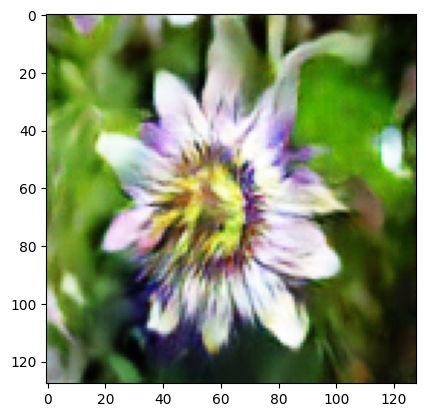

Epoch [620/1000] loss_D: 1.1097 loss_G: 1.9847 time: 9.15
Epoch [621/1000] loss_D: 1.0872 loss_G: 2.0573 time: 9.07
Epoch [622/1000] loss_D: 1.1044 loss_G: 2.0337 time: 9.03
Epoch [623/1000] loss_D: 1.1302 loss_G: 2.0284 time: 9.04
Epoch [624/1000] loss_D: 1.1045 loss_G: 2.0158 time: 9.17
Epoch [625/1000] loss_D: 1.0939 loss_G: 2.0572 time: 8.97
Epoch [626/1000] loss_D: 1.1531 loss_G: 1.9437 time: 8.95
Epoch [627/1000] loss_D: 1.0794 loss_G: 2.0364 time: 8.95
Epoch [628/1000] loss_D: 1.1116 loss_G: 2.0041 time: 8.96
Epoch [629/1000] loss_D: 1.0939 loss_G: 2.0399 time: 8.98


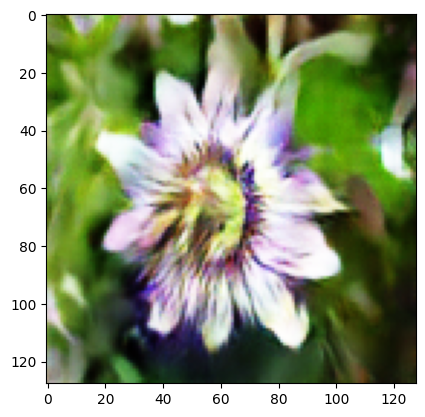

Epoch [630/1000] loss_D: 1.0684 loss_G: 2.0702 time: 9.08
Epoch [631/1000] loss_D: 1.1279 loss_G: 2.0508 time: 8.99
Epoch [632/1000] loss_D: 1.0904 loss_G: 2.0265 time: 8.92
Epoch [633/1000] loss_D: 1.1047 loss_G: 2.0303 time: 8.93
Epoch [634/1000] loss_D: 1.0771 loss_G: 2.0758 time: 8.95
Epoch [635/1000] loss_D: 1.0813 loss_G: 2.0301 time: 8.95
Epoch [636/1000] loss_D: 1.1546 loss_G: 1.9812 time: 8.93
Epoch [637/1000] loss_D: 1.0860 loss_G: 2.0636 time: 8.98
Epoch [638/1000] loss_D: 1.0799 loss_G: 2.0589 time: 8.95
Epoch [639/1000] loss_D: 1.1852 loss_G: 1.9595 time: 8.95


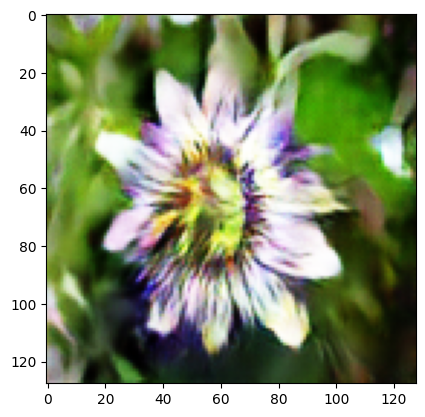

Epoch [640/1000] loss_D: 1.0849 loss_G: 2.0441 time: 9.10
Epoch [641/1000] loss_D: 1.0907 loss_G: 2.0388 time: 9.07
Epoch [642/1000] loss_D: 1.1056 loss_G: 2.0237 time: 8.96
Epoch [643/1000] loss_D: 1.0641 loss_G: 2.0992 time: 8.97
Epoch [644/1000] loss_D: 1.1059 loss_G: 2.0145 time: 9.03
Epoch [645/1000] loss_D: 1.1354 loss_G: 1.9995 time: 9.03
Epoch [646/1000] loss_D: 1.1131 loss_G: 2.0531 time: 9.01
Epoch [647/1000] loss_D: 1.1016 loss_G: 2.0336 time: 9.01
Epoch [648/1000] loss_D: 1.0883 loss_G: 2.0503 time: 9.05
Epoch [649/1000] loss_D: 1.0660 loss_G: 2.1192 time: 9.01


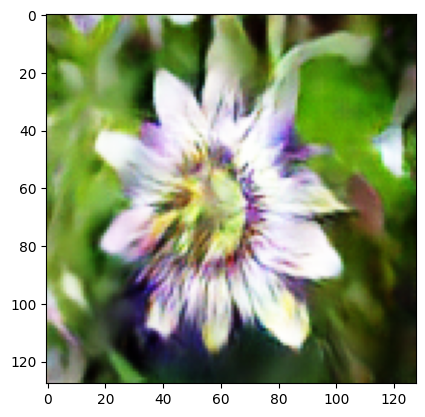

Epoch [650/1000] loss_D: 1.0921 loss_G: 2.0568 time: 9.12
Epoch [651/1000] loss_D: 1.0948 loss_G: 2.0432 time: 9.03
Epoch [652/1000] loss_D: 1.0841 loss_G: 2.0599 time: 9.02
Epoch [653/1000] loss_D: 1.1117 loss_G: 2.0274 time: 8.99
Epoch [654/1000] loss_D: 1.1196 loss_G: 2.0316 time: 8.99
Epoch [655/1000] loss_D: 1.0630 loss_G: 2.1586 time: 9.03
Epoch [656/1000] loss_D: 1.1410 loss_G: 1.9305 time: 8.98
Epoch [657/1000] loss_D: 1.0803 loss_G: 2.0631 time: 9.04
Epoch [658/1000] loss_D: 1.1154 loss_G: 2.0473 time: 9.01
Epoch [659/1000] loss_D: 1.0817 loss_G: 2.0736 time: 9.03


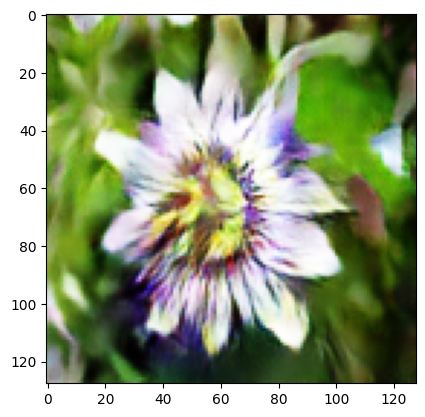

Epoch [660/1000] loss_D: 1.0911 loss_G: 2.0723 time: 9.09
Epoch [661/1000] loss_D: 1.1538 loss_G: 1.9798 time: 9.06
Epoch [662/1000] loss_D: 1.0627 loss_G: 2.0902 time: 9.03
Epoch [663/1000] loss_D: 1.0809 loss_G: 2.0631 time: 9.05
Epoch [664/1000] loss_D: 1.1004 loss_G: 2.0474 time: 8.99
Epoch [665/1000] loss_D: 1.1091 loss_G: 2.0587 time: 8.97
Epoch [666/1000] loss_D: 1.0593 loss_G: 2.0904 time: 8.99
Epoch [667/1000] loss_D: 1.1231 loss_G: 2.0520 time: 8.96
Epoch [668/1000] loss_D: 1.0764 loss_G: 2.1060 time: 8.96
Epoch [669/1000] loss_D: 1.0798 loss_G: 2.0886 time: 8.98


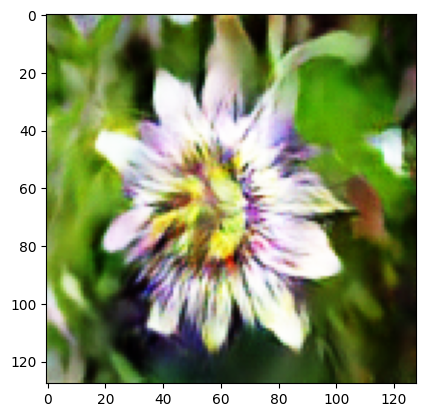

Epoch [670/1000] loss_D: 1.0790 loss_G: 2.0591 time: 9.10
Epoch [671/1000] loss_D: 1.0970 loss_G: 2.0623 time: 8.99
Epoch [672/1000] loss_D: 1.0817 loss_G: 2.0799 time: 8.97
Epoch [673/1000] loss_D: 1.0946 loss_G: 2.0725 time: 8.96
Epoch [674/1000] loss_D: 1.0939 loss_G: 2.0877 time: 8.99
Epoch [675/1000] loss_D: 1.0985 loss_G: 2.0939 time: 8.96
Epoch [676/1000] loss_D: 1.0325 loss_G: 2.1195 time: 8.97
Epoch [677/1000] loss_D: 1.2905 loss_G: 2.0463 time: 9.00
Epoch [678/1000] loss_D: 1.7293 loss_G: 1.6348 time: 8.95
Epoch [679/1000] loss_D: 1.2639 loss_G: 1.5540 time: 8.95


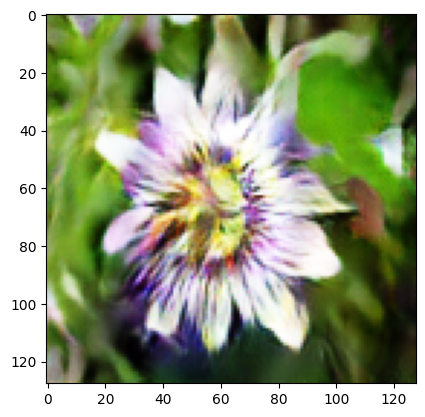

Epoch [680/1000] loss_D: 1.1809 loss_G: 1.7975 time: 9.08
Epoch [681/1000] loss_D: 1.1617 loss_G: 1.8572 time: 9.10
Epoch [682/1000] loss_D: 1.1000 loss_G: 1.9771 time: 9.02
Epoch [683/1000] loss_D: 1.0899 loss_G: 2.0462 time: 8.99
Epoch [684/1000] loss_D: 1.0665 loss_G: 2.0638 time: 8.99
Epoch [685/1000] loss_D: 1.1449 loss_G: 1.9626 time: 8.98
Epoch [686/1000] loss_D: 1.0572 loss_G: 2.0938 time: 9.01
Epoch [687/1000] loss_D: 1.0695 loss_G: 2.0835 time: 9.01
Epoch [688/1000] loss_D: 1.0844 loss_G: 2.0456 time: 9.06
Epoch [689/1000] loss_D: 1.0788 loss_G: 2.0621 time: 8.97


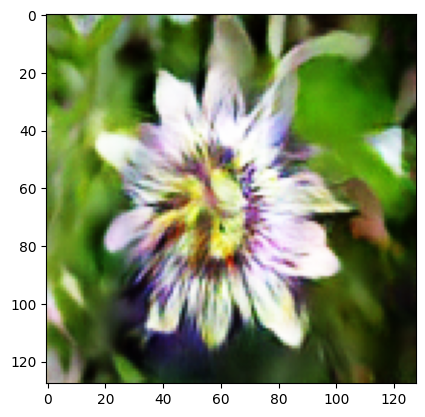

Epoch [690/1000] loss_D: 1.0527 loss_G: 2.1392 time: 9.10
Epoch [691/1000] loss_D: 1.0475 loss_G: 2.3258 time: 9.11
Epoch [692/1000] loss_D: 0.9898 loss_G: 2.5181 time: 9.04
Epoch [693/1000] loss_D: 1.0862 loss_G: 2.0620 time: 8.99
Epoch [694/1000] loss_D: 1.0908 loss_G: 2.0324 time: 8.99
Epoch [695/1000] loss_D: 1.0727 loss_G: 2.0745 time: 9.02
Epoch [696/1000] loss_D: 1.1070 loss_G: 2.0465 time: 9.01
Epoch [697/1000] loss_D: 1.0810 loss_G: 2.0731 time: 9.02
Epoch [698/1000] loss_D: 1.0536 loss_G: 2.0826 time: 9.04
Epoch [699/1000] loss_D: 1.1094 loss_G: 2.0481 time: 9.03


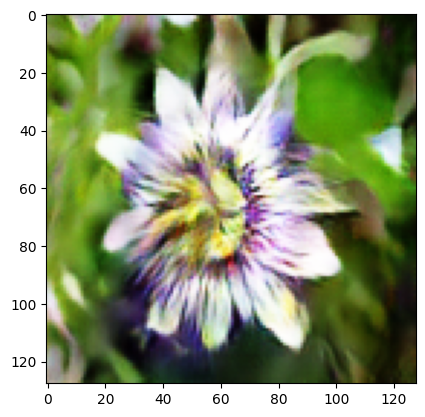

Epoch [700/1000] loss_D: 1.0948 loss_G: 2.0873 time: 9.08
Epoch [701/1000] loss_D: 1.1312 loss_G: 1.9957 time: 9.06
Epoch [702/1000] loss_D: 1.0651 loss_G: 2.0773 time: 9.03
Epoch [703/1000] loss_D: 1.0600 loss_G: 2.1195 time: 9.00
Epoch [704/1000] loss_D: 1.0837 loss_G: 2.0894 time: 9.00
Epoch [705/1000] loss_D: 1.0553 loss_G: 2.1092 time: 8.93
Epoch [706/1000] loss_D: 1.0818 loss_G: 2.0570 time: 8.95
Epoch [707/1000] loss_D: 1.0735 loss_G: 2.0865 time: 8.92
Epoch [708/1000] loss_D: 1.1275 loss_G: 2.0451 time: 8.94
Epoch [709/1000] loss_D: 1.0390 loss_G: 2.1951 time: 8.95


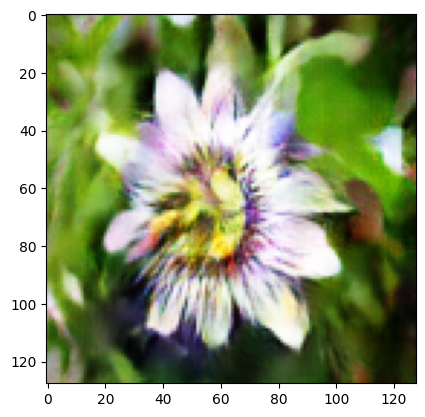

Epoch [710/1000] loss_D: 0.9601 loss_G: 2.6336 time: 9.10
Epoch [711/1000] loss_D: 1.0362 loss_G: 2.2301 time: 8.99
Epoch [712/1000] loss_D: 1.1408 loss_G: 2.1043 time: 8.94
Epoch [713/1000] loss_D: 1.0523 loss_G: 2.0924 time: 8.99
Epoch [714/1000] loss_D: 1.0904 loss_G: 2.1028 time: 8.96
Epoch [715/1000] loss_D: 1.0586 loss_G: 2.0795 time: 8.98
Epoch [716/1000] loss_D: 1.0965 loss_G: 2.0952 time: 8.99
Epoch [717/1000] loss_D: 1.0850 loss_G: 2.1520 time: 9.00
Epoch [718/1000] loss_D: 1.0662 loss_G: 2.0511 time: 8.97
Epoch [719/1000] loss_D: 1.0532 loss_G: 2.3549 time: 8.96


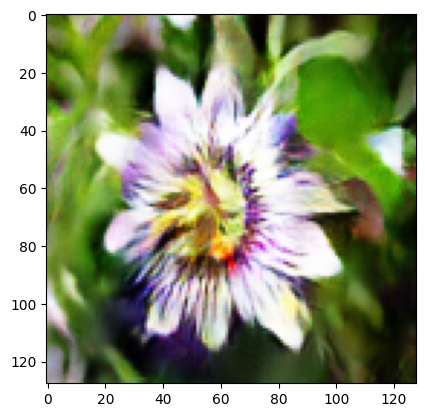

Epoch [720/1000] loss_D: 1.0319 loss_G: 2.4957 time: 9.11
Epoch [721/1000] loss_D: 1.1078 loss_G: 2.0884 time: 9.07
Epoch [722/1000] loss_D: 1.0804 loss_G: 2.0244 time: 9.00
Epoch [723/1000] loss_D: 1.0678 loss_G: 2.1073 time: 9.00
Epoch [724/1000] loss_D: 1.0645 loss_G: 2.1047 time: 8.99
Epoch [725/1000] loss_D: 1.0751 loss_G: 2.1123 time: 9.07
Epoch [726/1000] loss_D: 1.0797 loss_G: 2.0858 time: 9.01
Epoch [727/1000] loss_D: 1.0458 loss_G: 2.2268 time: 9.00
Epoch [728/1000] loss_D: 0.9364 loss_G: 2.8989 time: 9.06
Epoch [729/1000] loss_D: 1.1997 loss_G: 2.3344 time: 9.01


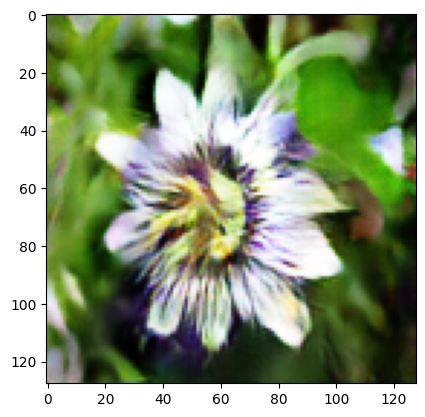

Epoch [730/1000] loss_D: 0.9479 loss_G: 2.7201 time: 9.11
Epoch [731/1000] loss_D: 0.9638 loss_G: 2.7391 time: 9.10
Epoch [732/1000] loss_D: 0.8637 loss_G: 3.2084 time: 9.09
Epoch [733/1000] loss_D: 1.0256 loss_G: 2.6879 time: 9.04
Epoch [734/1000] loss_D: 0.9559 loss_G: 2.8985 time: 9.02
Epoch [735/1000] loss_D: 1.1185 loss_G: 2.7508 time: 9.06
Epoch [736/1000] loss_D: 0.9930 loss_G: 2.4182 time: 9.03
Epoch [737/1000] loss_D: 0.9118 loss_G: 2.9834 time: 9.05
Epoch [738/1000] loss_D: 0.8885 loss_G: 3.0588 time: 9.05
Epoch [739/1000] loss_D: 0.8552 loss_G: 3.1748 time: 9.05


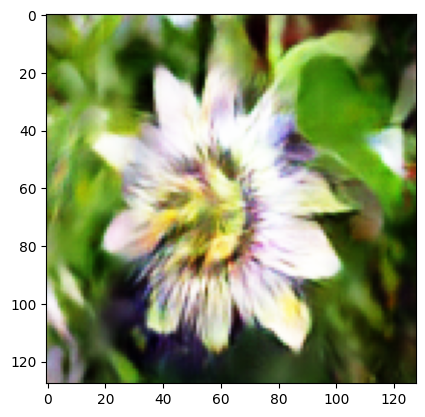

Epoch [740/1000] loss_D: 1.0475 loss_G: 2.5153 time: 9.14
Epoch [741/1000] loss_D: 0.8916 loss_G: 2.9878 time: 9.11
Epoch [742/1000] loss_D: 0.9402 loss_G: 3.0349 time: 9.02
Epoch [743/1000] loss_D: 0.9292 loss_G: 2.8111 time: 9.02
Epoch [744/1000] loss_D: 0.8715 loss_G: 3.1237 time: 9.01
Epoch [745/1000] loss_D: 0.9473 loss_G: 2.9171 time: 8.96
Epoch [746/1000] loss_D: 0.9170 loss_G: 2.8372 time: 8.96
Epoch [747/1000] loss_D: 1.5720 loss_G: 2.9995 time: 8.96
Epoch [748/1000] loss_D: 1.5955 loss_G: 1.2820 time: 8.99
Epoch [749/1000] loss_D: 1.4295 loss_G: 1.3813 time: 8.98


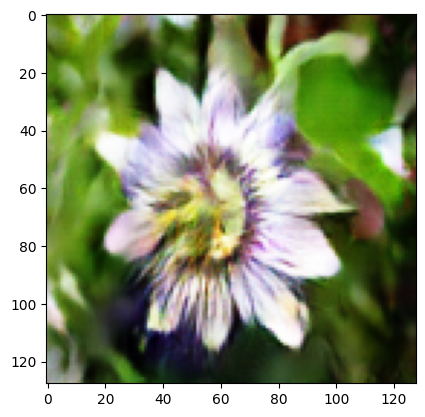

Epoch [750/1000] loss_D: 1.3300 loss_G: 1.4362 time: 9.13
Epoch [751/1000] loss_D: 1.2307 loss_G: 1.6143 time: 9.04
Epoch [752/1000] loss_D: 1.1387 loss_G: 1.8338 time: 8.98
Epoch [753/1000] loss_D: 1.1273 loss_G: 1.8889 time: 8.98
Epoch [754/1000] loss_D: 1.1249 loss_G: 1.9280 time: 8.99
Epoch [755/1000] loss_D: 1.0783 loss_G: 1.9759 time: 8.97
Epoch [756/1000] loss_D: 1.0985 loss_G: 2.0044 time: 8.95
Epoch [757/1000] loss_D: 1.1262 loss_G: 1.9758 time: 9.00
Epoch [758/1000] loss_D: 1.0606 loss_G: 2.0253 time: 9.00
Epoch [759/1000] loss_D: 1.1113 loss_G: 2.0202 time: 8.98


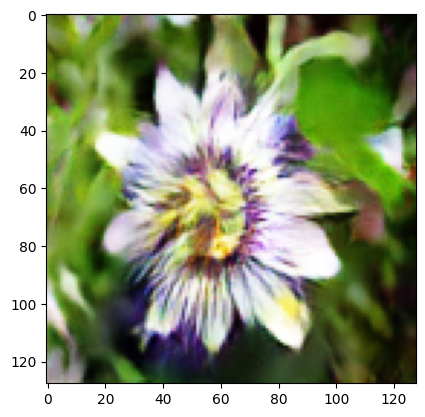

Epoch [760/1000] loss_D: 1.0707 loss_G: 2.0441 time: 9.08
Epoch [761/1000] loss_D: 1.0805 loss_G: 2.0207 time: 9.10
Epoch [762/1000] loss_D: 1.0733 loss_G: 2.0434 time: 8.97
Epoch [763/1000] loss_D: 1.1054 loss_G: 2.0222 time: 8.97
Epoch [764/1000] loss_D: 1.0540 loss_G: 2.0944 time: 9.00
Epoch [765/1000] loss_D: 1.0981 loss_G: 2.0111 time: 9.02
Epoch [766/1000] loss_D: 1.0622 loss_G: 2.0618 time: 8.98
Epoch [767/1000] loss_D: 1.1045 loss_G: 2.0223 time: 8.99
Epoch [768/1000] loss_D: 1.0591 loss_G: 2.0468 time: 9.05
Epoch [769/1000] loss_D: 0.9891 loss_G: 2.4874 time: 9.02


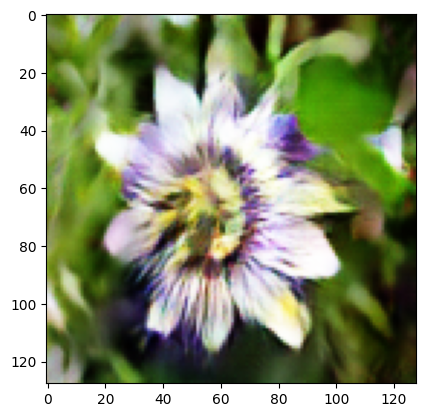

Epoch [770/1000] loss_D: 1.0330 loss_G: 2.3944 time: 9.11
Epoch [771/1000] loss_D: 1.0524 loss_G: 2.1590 time: 9.07
Epoch [772/1000] loss_D: 1.0644 loss_G: 2.0471 time: 9.05
Epoch [773/1000] loss_D: 1.0973 loss_G: 2.0302 time: 9.04
Epoch [774/1000] loss_D: 1.0712 loss_G: 2.0758 time: 9.00
Epoch [775/1000] loss_D: 1.0735 loss_G: 2.0701 time: 9.04
Epoch [776/1000] loss_D: 1.0500 loss_G: 2.1136 time: 9.05
Epoch [777/1000] loss_D: 1.1169 loss_G: 1.9863 time: 9.01
Epoch [778/1000] loss_D: 1.0804 loss_G: 2.0677 time: 9.04
Epoch [779/1000] loss_D: 1.0844 loss_G: 2.0432 time: 9.01


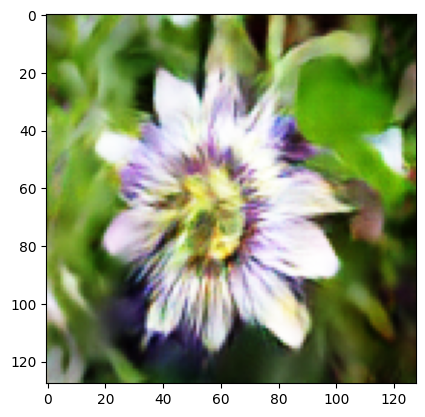

Epoch [780/1000] loss_D: 1.0752 loss_G: 2.0604 time: 9.13
Epoch [781/1000] loss_D: 1.1063 loss_G: 2.0503 time: 9.08
Epoch [782/1000] loss_D: 1.0717 loss_G: 2.0664 time: 9.02
Epoch [783/1000] loss_D: 1.0798 loss_G: 2.0734 time: 9.09
Epoch [784/1000] loss_D: 1.0825 loss_G: 2.0741 time: 8.98
Epoch [785/1000] loss_D: 1.0486 loss_G: 2.1290 time: 8.98
Epoch [786/1000] loss_D: 1.1255 loss_G: 2.0033 time: 9.01
Epoch [787/1000] loss_D: 1.0858 loss_G: 2.0280 time: 8.99
Epoch [788/1000] loss_D: 1.0801 loss_G: 2.0826 time: 8.98
Epoch [789/1000] loss_D: 1.0718 loss_G: 2.1063 time: 8.97


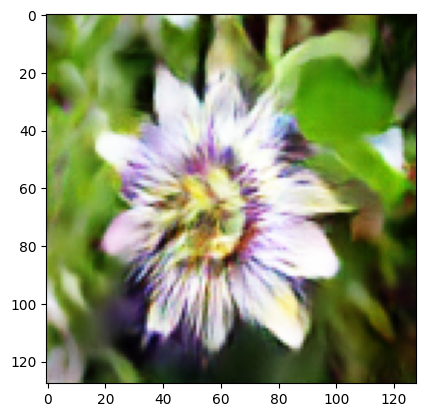

Epoch [790/1000] loss_D: 1.1197 loss_G: 2.0969 time: 9.10
Epoch [791/1000] loss_D: 1.0623 loss_G: 2.0339 time: 9.09
Epoch [792/1000] loss_D: 1.0659 loss_G: 2.1163 time: 8.97
Epoch [793/1000] loss_D: 1.0769 loss_G: 2.0766 time: 8.99
Epoch [794/1000] loss_D: 1.1382 loss_G: 1.9908 time: 9.01
Epoch [795/1000] loss_D: 1.0852 loss_G: 2.0171 time: 8.99
Epoch [796/1000] loss_D: 1.0681 loss_G: 2.1049 time: 8.98
Epoch [797/1000] loss_D: 1.0657 loss_G: 2.0975 time: 8.98
Epoch [798/1000] loss_D: 1.2976 loss_G: 2.0383 time: 8.98
Epoch [799/1000] loss_D: 1.1588 loss_G: 1.7907 time: 8.99


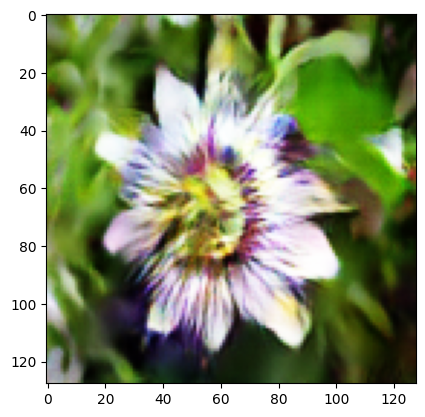

Epoch [800/1000] loss_D: 1.0894 loss_G: 1.9717 time: 9.10
Epoch [801/1000] loss_D: 1.0694 loss_G: 2.0724 time: 9.10
Epoch [802/1000] loss_D: 1.1027 loss_G: 2.0649 time: 9.01
Epoch [803/1000] loss_D: 1.0627 loss_G: 2.0564 time: 8.98
Epoch [804/1000] loss_D: 1.0723 loss_G: 2.0677 time: 9.01
Epoch [805/1000] loss_D: 1.0661 loss_G: 2.1074 time: 9.09
Epoch [806/1000] loss_D: 1.0763 loss_G: 2.0970 time: 9.01
Epoch [807/1000] loss_D: 1.0532 loss_G: 2.1165 time: 9.04
Epoch [808/1000] loss_D: 1.0819 loss_G: 2.0880 time: 9.05
Epoch [809/1000] loss_D: 1.0287 loss_G: 2.1548 time: 9.08


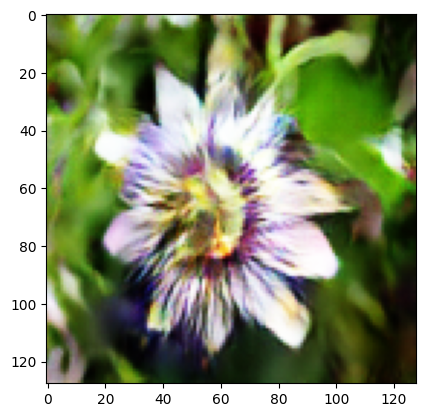

Epoch [810/1000] loss_D: 1.0725 loss_G: 2.1109 time: 9.14
Epoch [811/1000] loss_D: 1.0796 loss_G: 2.0686 time: 9.07
Epoch [812/1000] loss_D: 1.0637 loss_G: 2.0927 time: 9.06
Epoch [813/1000] loss_D: 1.0835 loss_G: 2.0880 time: 9.05
Epoch [814/1000] loss_D: 1.0709 loss_G: 2.0886 time: 9.05
Epoch [815/1000] loss_D: 1.0647 loss_G: 2.1276 time: 9.06
Epoch [816/1000] loss_D: 1.0625 loss_G: 2.1239 time: 9.06
Epoch [817/1000] loss_D: 1.0754 loss_G: 2.1069 time: 9.03
Epoch [818/1000] loss_D: 1.0905 loss_G: 2.0934 time: 9.02
Epoch [819/1000] loss_D: 1.0736 loss_G: 2.0887 time: 9.07


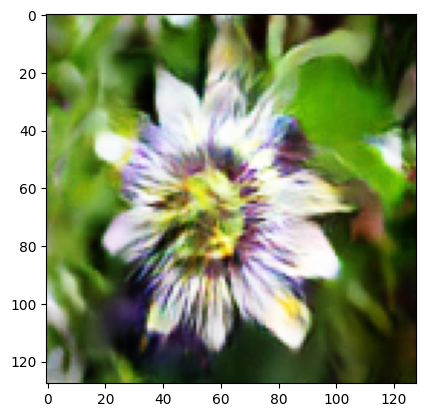

Epoch [820/1000] loss_D: 1.0603 loss_G: 2.1291 time: 9.12
Epoch [821/1000] loss_D: 1.0432 loss_G: 2.1346 time: 9.09
Epoch [822/1000] loss_D: 1.1142 loss_G: 2.0509 time: 9.05
Epoch [823/1000] loss_D: 1.0563 loss_G: 2.1084 time: 9.07
Epoch [824/1000] loss_D: 1.0627 loss_G: 2.1279 time: 9.01
Epoch [825/1000] loss_D: 1.0668 loss_G: 2.1203 time: 8.98
Epoch [826/1000] loss_D: 1.0634 loss_G: 2.1897 time: 8.97
Epoch [827/1000] loss_D: 1.0774 loss_G: 2.0844 time: 9.00
Epoch [828/1000] loss_D: 1.0627 loss_G: 2.1174 time: 9.00
Epoch [829/1000] loss_D: 1.1046 loss_G: 2.0743 time: 8.99


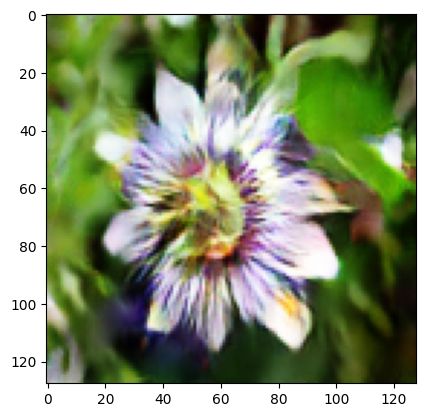

Epoch [830/1000] loss_D: 1.0533 loss_G: 2.1366 time: 9.12
Epoch [831/1000] loss_D: 1.0433 loss_G: 2.1360 time: 9.04
Epoch [832/1000] loss_D: 1.1160 loss_G: 2.0705 time: 8.98
Epoch [833/1000] loss_D: 1.0617 loss_G: 2.1159 time: 8.99
Epoch [834/1000] loss_D: 1.0657 loss_G: 2.0906 time: 9.00
Epoch [835/1000] loss_D: 1.1144 loss_G: 2.0698 time: 8.98
Epoch [836/1000] loss_D: 1.0316 loss_G: 2.1401 time: 8.99
Epoch [837/1000] loss_D: 1.1078 loss_G: 2.0489 time: 9.00
Epoch [838/1000] loss_D: 1.0599 loss_G: 2.1028 time: 8.98
Epoch [839/1000] loss_D: 1.0636 loss_G: 2.1187 time: 8.99


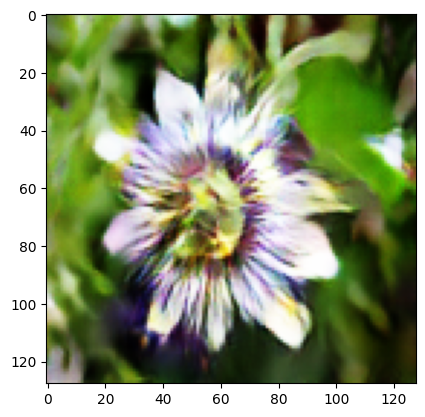

Epoch [840/1000] loss_D: 1.0867 loss_G: 2.0914 time: 9.08
Epoch [841/1000] loss_D: 1.0467 loss_G: 2.1356 time: 9.05
Epoch [842/1000] loss_D: 1.0586 loss_G: 2.1446 time: 9.00
Epoch [843/1000] loss_D: 1.0639 loss_G: 2.1149 time: 8.97
Epoch [844/1000] loss_D: 1.0801 loss_G: 2.1132 time: 8.98
Epoch [845/1000] loss_D: 1.1042 loss_G: 2.0857 time: 9.03
Epoch [846/1000] loss_D: 1.0596 loss_G: 2.0960 time: 9.01
Epoch [847/1000] loss_D: 1.0593 loss_G: 2.1223 time: 8.99
Epoch [848/1000] loss_D: 1.0773 loss_G: 2.1326 time: 9.01
Epoch [849/1000] loss_D: 1.0662 loss_G: 2.1319 time: 9.00


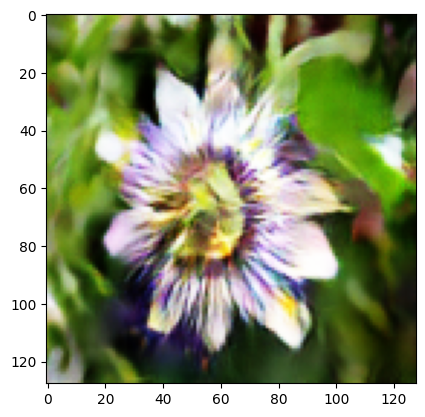

Epoch [850/1000] loss_D: 1.0548 loss_G: 2.1305 time: 9.10
Epoch [851/1000] loss_D: 1.0629 loss_G: 2.0963 time: 9.08
Epoch [852/1000] loss_D: 1.0504 loss_G: 2.2569 time: 9.08
Epoch [853/1000] loss_D: 1.0886 loss_G: 2.1204 time: 9.04
Epoch [854/1000] loss_D: 1.0691 loss_G: 2.1236 time: 9.03
Epoch [855/1000] loss_D: 1.0591 loss_G: 2.1273 time: 9.07
Epoch [856/1000] loss_D: 1.0968 loss_G: 2.0919 time: 9.06
Epoch [857/1000] loss_D: 1.0621 loss_G: 2.1147 time: 9.03
Epoch [858/1000] loss_D: 1.0632 loss_G: 2.1171 time: 9.01
Epoch [859/1000] loss_D: 1.0578 loss_G: 2.1142 time: 9.03


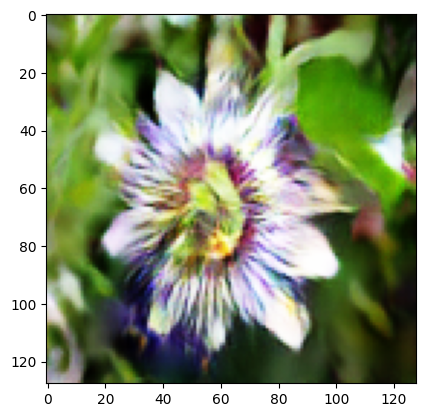

Epoch [860/1000] loss_D: 1.0449 loss_G: 2.2480 time: 9.17
Epoch [861/1000] loss_D: 1.0027 loss_G: 2.3953 time: 9.06
Epoch [862/1000] loss_D: 1.0931 loss_G: 2.0861 time: 9.03
Epoch [863/1000] loss_D: 1.0373 loss_G: 2.1647 time: 9.04
Epoch [864/1000] loss_D: 1.0882 loss_G: 2.1085 time: 9.02
Epoch [865/1000] loss_D: 1.0439 loss_G: 2.2352 time: 8.97
Epoch [866/1000] loss_D: 0.9524 loss_G: 2.8206 time: 8.99
Epoch [867/1000] loss_D: 1.2167 loss_G: 2.7296 time: 8.99
Epoch [868/1000] loss_D: 1.1834 loss_G: 2.0185 time: 8.96
Epoch [869/1000] loss_D: 1.0324 loss_G: 2.5627 time: 8.98


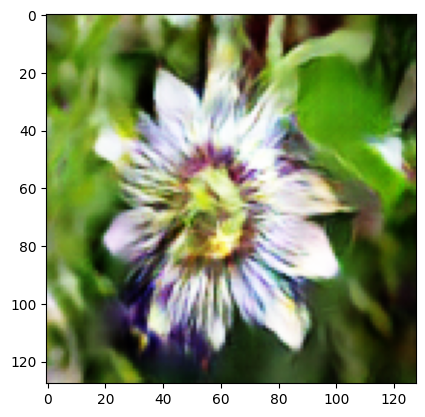

Epoch [870/1000] loss_D: 1.0540 loss_G: 2.1757 time: 9.09
Epoch [871/1000] loss_D: 0.8929 loss_G: 2.8988 time: 9.06
Epoch [872/1000] loss_D: 0.8666 loss_G: 3.1484 time: 8.97
Epoch [873/1000] loss_D: 0.8762 loss_G: 3.0857 time: 9.00
Epoch [874/1000] loss_D: 0.8805 loss_G: 3.2368 time: 9.00
Epoch [875/1000] loss_D: 0.9021 loss_G: 3.0228 time: 8.99
Epoch [876/1000] loss_D: 0.8931 loss_G: 3.0674 time: 8.98
Epoch [877/1000] loss_D: 0.8656 loss_G: 3.1095 time: 8.99
Epoch [878/1000] loss_D: 0.9951 loss_G: 2.7007 time: 9.06
Epoch [879/1000] loss_D: 0.8734 loss_G: 3.0779 time: 9.00


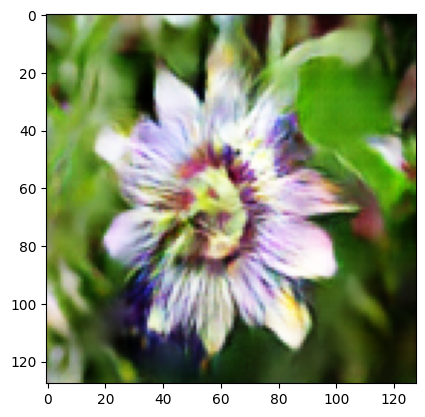

Epoch [880/1000] loss_D: 0.9488 loss_G: 2.8940 time: 9.11
Epoch [881/1000] loss_D: 1.0327 loss_G: 2.3764 time: 9.10
Epoch [882/1000] loss_D: 0.9676 loss_G: 2.6170 time: 9.02
Epoch [883/1000] loss_D: 0.9956 loss_G: 2.5273 time: 9.02
Epoch [884/1000] loss_D: 0.9729 loss_G: 2.6357 time: 9.03
Epoch [885/1000] loss_D: 0.9257 loss_G: 2.6972 time: 9.05
Epoch [886/1000] loss_D: 0.9222 loss_G: 2.7421 time: 9.06
Epoch [887/1000] loss_D: 0.9608 loss_G: 2.8860 time: 9.06
Epoch [888/1000] loss_D: 0.8754 loss_G: 3.1298 time: 9.07
Epoch [889/1000] loss_D: 0.9651 loss_G: 2.7335 time: 9.07


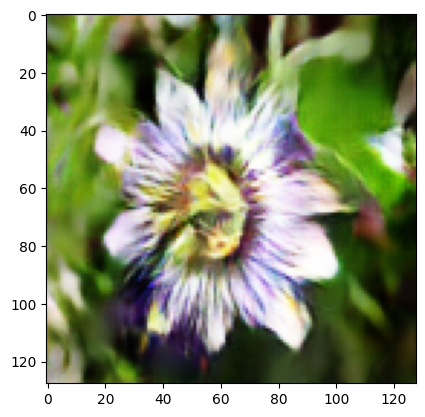

Epoch [890/1000] loss_D: 0.9756 loss_G: 2.6481 time: 9.18
Epoch [891/1000] loss_D: 0.9474 loss_G: 2.6314 time: 9.06
Epoch [892/1000] loss_D: 0.9558 loss_G: 2.7255 time: 9.01
Epoch [893/1000] loss_D: 0.9164 loss_G: 2.8055 time: 9.03
Epoch [894/1000] loss_D: 0.9455 loss_G: 2.8191 time: 9.02
Epoch [895/1000] loss_D: 0.9324 loss_G: 2.8046 time: 9.02
Epoch [896/1000] loss_D: 0.9083 loss_G: 2.7746 time: 9.02
Epoch [897/1000] loss_D: 0.9209 loss_G: 2.8027 time: 9.00
Epoch [898/1000] loss_D: 1.0886 loss_G: 2.5421 time: 9.02
Epoch [899/1000] loss_D: 0.9848 loss_G: 2.3739 time: 9.03


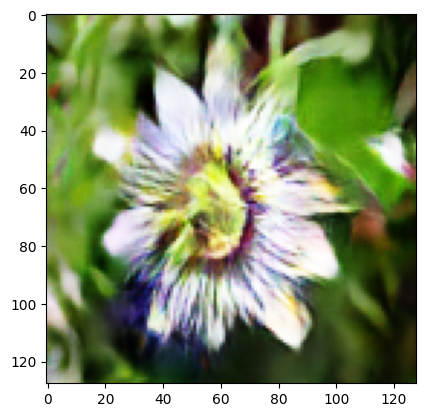

Epoch [900/1000] loss_D: 0.9407 loss_G: 2.6251 time: 9.16
Epoch [901/1000] loss_D: 0.9464 loss_G: 2.6211 time: 9.08
Epoch [902/1000] loss_D: 0.9717 loss_G: 2.6846 time: 9.00
Epoch [903/1000] loss_D: 0.9275 loss_G: 2.7564 time: 9.06
Epoch [904/1000] loss_D: 0.9025 loss_G: 2.8193 time: 8.97
Epoch [905/1000] loss_D: 1.0013 loss_G: 2.6729 time: 8.93
Epoch [906/1000] loss_D: 1.0220 loss_G: 2.3420 time: 8.98
Epoch [907/1000] loss_D: 0.9878 loss_G: 2.4179 time: 8.96
Epoch [908/1000] loss_D: 0.9876 loss_G: 2.4018 time: 9.01
Epoch [909/1000] loss_D: 0.9685 loss_G: 2.5439 time: 8.96


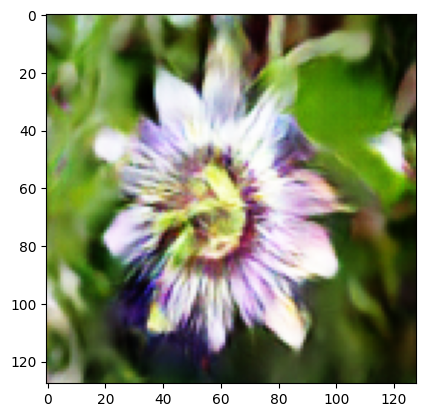

Epoch [910/1000] loss_D: 0.9965 loss_G: 2.4378 time: 9.07
Epoch [911/1000] loss_D: 1.0161 loss_G: 2.4188 time: 9.06
Epoch [912/1000] loss_D: 0.9460 loss_G: 2.6170 time: 8.97
Epoch [913/1000] loss_D: 0.9362 loss_G: 2.7827 time: 8.94
Epoch [914/1000] loss_D: 0.9557 loss_G: 2.6753 time: 8.99
Epoch [915/1000] loss_D: 0.9395 loss_G: 2.8310 time: 9.02
Epoch [916/1000] loss_D: 0.9243 loss_G: 2.7084 time: 8.97
Epoch [917/1000] loss_D: 0.9776 loss_G: 2.6700 time: 8.97
Epoch [918/1000] loss_D: 0.9830 loss_G: 2.5788 time: 9.02
Epoch [919/1000] loss_D: 0.9422 loss_G: 2.5327 time: 8.96


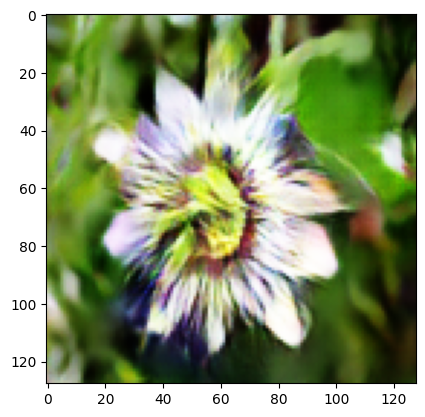

Epoch [920/1000] loss_D: 0.9624 loss_G: 2.6504 time: 9.08
Epoch [921/1000] loss_D: 0.9598 loss_G: 2.5841 time: 9.04
Epoch [922/1000] loss_D: 0.9491 loss_G: 2.6510 time: 9.03
Epoch [923/1000] loss_D: 0.9392 loss_G: 2.6562 time: 8.99
Epoch [924/1000] loss_D: 0.9841 loss_G: 2.5533 time: 9.01
Epoch [925/1000] loss_D: 0.9539 loss_G: 2.6238 time: 9.02
Epoch [926/1000] loss_D: 0.9443 loss_G: 2.5837 time: 9.00
Epoch [927/1000] loss_D: 0.9665 loss_G: 2.6500 time: 8.97
Epoch [928/1000] loss_D: 0.9606 loss_G: 2.6590 time: 9.00
Epoch [929/1000] loss_D: 0.9502 loss_G: 2.6155 time: 9.04


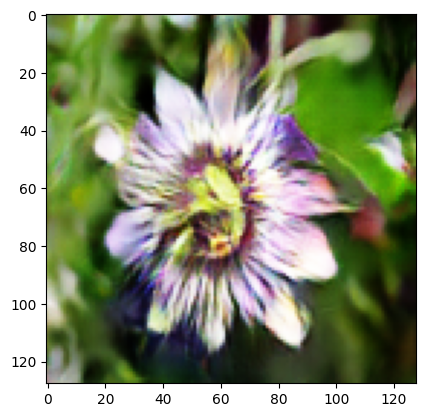

Epoch [930/1000] loss_D: 0.9382 loss_G: 2.6988 time: 9.13
Epoch [931/1000] loss_D: 0.9568 loss_G: 2.6515 time: 9.11
Epoch [932/1000] loss_D: 0.9376 loss_G: 2.7098 time: 9.09
Epoch [933/1000] loss_D: 1.0291 loss_G: 2.4988 time: 9.06
Epoch [934/1000] loss_D: 0.9728 loss_G: 2.4783 time: 9.08
Epoch [935/1000] loss_D: 0.9271 loss_G: 2.6265 time: 9.04
Epoch [936/1000] loss_D: 0.9523 loss_G: 2.6222 time: 9.05
Epoch [937/1000] loss_D: 1.0216 loss_G: 2.4812 time: 9.05
Epoch [938/1000] loss_D: 0.9351 loss_G: 2.6654 time: 9.01
Epoch [939/1000] loss_D: 0.9516 loss_G: 2.6487 time: 9.06


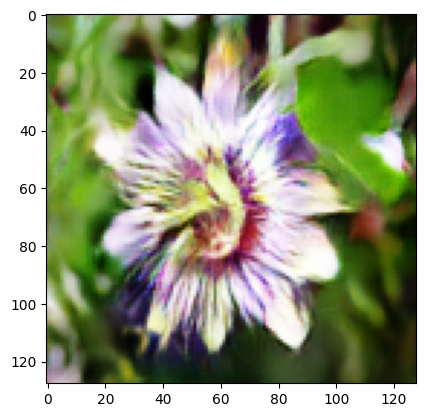

Epoch [940/1000] loss_D: 0.9466 loss_G: 2.6442 time: 9.31
Epoch [941/1000] loss_D: 0.9872 loss_G: 2.5668 time: 9.07
Epoch [942/1000] loss_D: 0.9801 loss_G: 2.5930 time: 9.04
Epoch [943/1000] loss_D: 0.9314 loss_G: 2.6136 time: 9.04
Epoch [944/1000] loss_D: 0.9522 loss_G: 2.6704 time: 9.03
Epoch [945/1000] loss_D: 0.8866 loss_G: 2.9454 time: 8.98
Epoch [946/1000] loss_D: 0.8774 loss_G: 3.1274 time: 8.99
Epoch [947/1000] loss_D: 1.0113 loss_G: 2.6872 time: 9.08
Epoch [948/1000] loss_D: 1.1156 loss_G: 2.1176 time: 9.00
Epoch [949/1000] loss_D: 1.0296 loss_G: 2.1896 time: 9.00


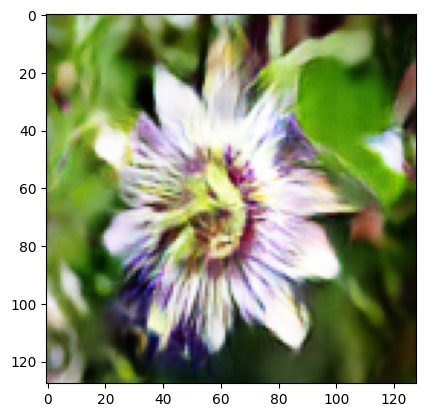

Epoch [950/1000] loss_D: 1.1054 loss_G: 2.1121 time: 9.10
Epoch [951/1000] loss_D: 1.0704 loss_G: 2.0396 time: 9.07
Epoch [952/1000] loss_D: 1.0724 loss_G: 2.0615 time: 9.00
Epoch [953/1000] loss_D: 1.0805 loss_G: 2.0808 time: 8.96
Epoch [954/1000] loss_D: 1.0584 loss_G: 2.1024 time: 9.04
Epoch [955/1000] loss_D: 1.1098 loss_G: 2.0553 time: 8.98
Epoch [956/1000] loss_D: 1.0520 loss_G: 2.0671 time: 8.98
Epoch [957/1000] loss_D: 1.1125 loss_G: 2.0724 time: 8.96
Epoch [958/1000] loss_D: 1.0452 loss_G: 2.1141 time: 9.03
Epoch [959/1000] loss_D: 1.0683 loss_G: 2.0920 time: 9.00


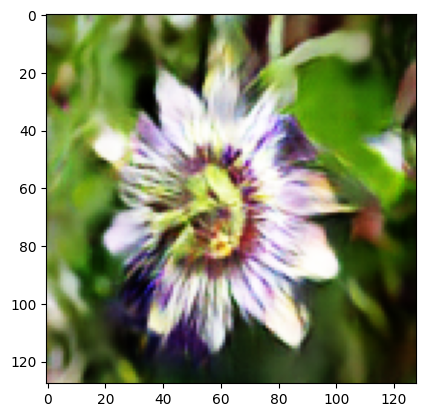

Epoch [960/1000] loss_D: 1.0581 loss_G: 2.0966 time: 9.08
Epoch [961/1000] loss_D: 1.0689 loss_G: 2.1124 time: 9.06
Epoch [962/1000] loss_D: 1.0646 loss_G: 2.0794 time: 9.05
Epoch [963/1000] loss_D: 1.0471 loss_G: 2.1585 time: 8.97
Epoch [964/1000] loss_D: 1.0635 loss_G: 2.1056 time: 8.99
Epoch [965/1000] loss_D: 1.0772 loss_G: 2.0891 time: 9.01
Epoch [966/1000] loss_D: 1.0452 loss_G: 2.1388 time: 9.04
Epoch [967/1000] loss_D: 1.0853 loss_G: 2.1061 time: 9.01
Epoch [968/1000] loss_D: 1.0455 loss_G: 2.1379 time: 8.99
Epoch [969/1000] loss_D: 1.0663 loss_G: 2.1114 time: 9.06


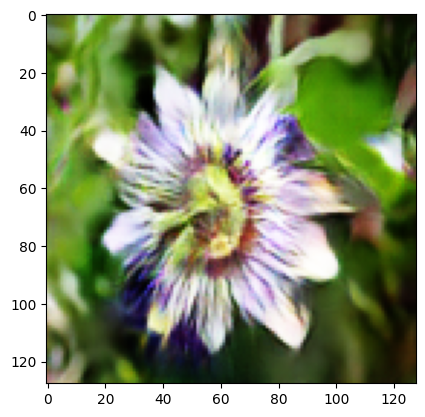

Epoch [970/1000] loss_D: 1.0632 loss_G: 2.1351 time: 9.12
Epoch [971/1000] loss_D: 1.0597 loss_G: 2.1326 time: 9.06
Epoch [972/1000] loss_D: 1.0771 loss_G: 2.0974 time: 9.03
Epoch [973/1000] loss_D: 1.0678 loss_G: 2.0973 time: 9.03
Epoch [974/1000] loss_D: 1.0881 loss_G: 2.0481 time: 9.03
Epoch [975/1000] loss_D: 1.0694 loss_G: 2.1019 time: 9.03
Epoch [976/1000] loss_D: 1.0750 loss_G: 2.1279 time: 9.06
Epoch [977/1000] loss_D: 1.0611 loss_G: 2.1087 time: 9.00
Epoch [978/1000] loss_D: 1.0404 loss_G: 2.1763 time: 9.02
Epoch [979/1000] loss_D: 1.0618 loss_G: 2.1218 time: 9.00


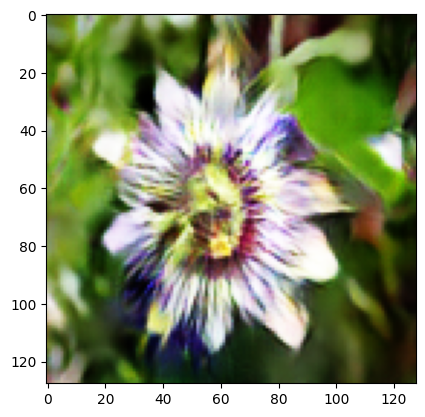

Epoch [980/1000] loss_D: 1.0718 loss_G: 2.1059 time: 9.11
Epoch [981/1000] loss_D: 1.0648 loss_G: 2.0790 time: 9.10
Epoch [982/1000] loss_D: 1.0577 loss_G: 2.1599 time: 9.04
Epoch [983/1000] loss_D: 1.0539 loss_G: 2.1309 time: 9.05
Epoch [984/1000] loss_D: 1.0550 loss_G: 2.1351 time: 9.00
Epoch [985/1000] loss_D: 1.0697 loss_G: 2.1991 time: 8.97
Epoch [986/1000] loss_D: 1.0804 loss_G: 2.1383 time: 8.99
Epoch [987/1000] loss_D: 1.0592 loss_G: 2.0999 time: 8.99
Epoch [988/1000] loss_D: 1.0286 loss_G: 2.1705 time: 9.05
Epoch [989/1000] loss_D: 1.0634 loss_G: 2.1504 time: 9.00


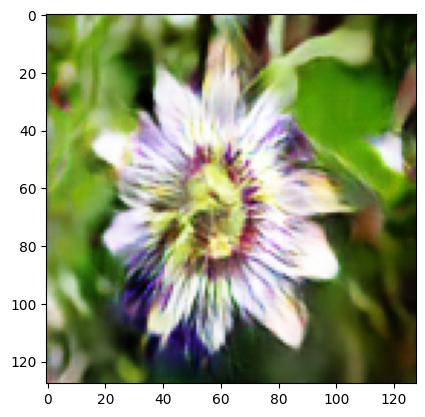

Epoch [990/1000] loss_D: 1.0616 loss_G: 2.1208 time: 9.08
Epoch [991/1000] loss_D: 1.0638 loss_G: 2.1110 time: 9.05
Epoch [992/1000] loss_D: 1.1064 loss_G: 2.1190 time: 8.98
Epoch [993/1000] loss_D: 1.0701 loss_G: 2.0856 time: 8.98
Epoch [994/1000] loss_D: 1.0561 loss_G: 2.1416 time: 9.00
Epoch [995/1000] loss_D: 1.0286 loss_G: 2.1769 time: 9.02
Epoch [996/1000] loss_D: 1.0552 loss_G: 2.1402 time: 8.97
Epoch [997/1000] loss_D: 1.0483 loss_G: 2.1443 time: 9.00
Epoch [998/1000] loss_D: 1.0805 loss_G: 2.1276 time: 9.04
Epoch [999/1000] loss_D: 1.0419 loss_G: 2.1587 time: 9.00


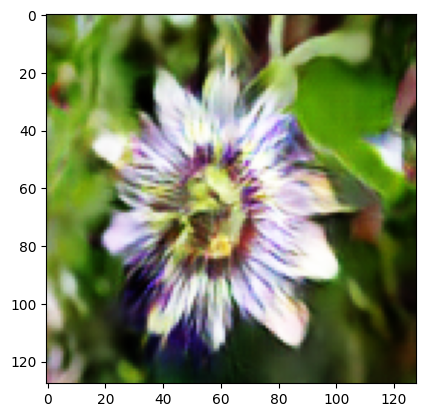

Epoch [1000/1000] loss_D: 1.0533 loss_G: 2.1462 time: 9.17


In [15]:
import time

epochs = 1000

for epoch in range(epochs):

    d_losses, g_losses = [], []
    epoch_time = time.time()

    for batch in dataloader:
        images = batch['image'].to(device) 
        embed_captions = batch['embed_caption'].to(device)  
        wrong_images = batch['wrong_image'].to(device)  

        real_labels = torch.ones((images.size(0), 1), device=device)
        fake_labels = torch.zeros((images.size(0), 1), device=device) 
        # Training the discriminator
        optimizer_D.zero_grad()

        noise = torch.randn(size=(images.size(0), 100), device=device)
        with torch.autocast(device_type="cuda", dtype=torch.bfloat16, cache_enabled=True, enabled=True):
            fake_images = generator(noise, embed_captions)

            outputs, _ = discriminator(images, embed_captions)
            real_loss = bce_loss(outputs, real_labels)

            outputs, _ = discriminator(wrong_images, embed_captions)
            wrong_loss = bce_loss(outputs, fake_labels)

            outputs, _ = discriminator(fake_images.detach(), embed_captions)
            fake_loss = bce_loss(outputs, fake_labels)
            d_loss = real_loss + fake_loss + wrong_loss

        d_loss.backward()
        optimizer_D.step()

        tg_loss = real_loss.item() + fake_loss.item()
        d_losses.append(tg_loss)

        # Training generator
        optimizer_G.zero_grad()
        noise = torch.randn(size=(images.size(0), 100), device=device)
        with torch.autocast(device_type="cuda", dtype=torch.bfloat16, cache_enabled=True, enabled=True):
            fake_images = generator(noise, embed_captions)

            outputs, fake_features = discriminator(fake_images, embed_captions)
            _, real_features = discriminator(images, embed_captions)

            activation_fake = torch.mean(fake_features, 0)
            activation_real = torch.mean(real_features, 0)

            real_loss = bce_loss(outputs, real_labels)

            g_loss = real_loss + 100 * l2_loss(activation_fake, activation_real.detach()) + 50 * l1_loss(fake_images, images)

        g_loss.backward()
        optimizer_G.step()

        g_losses.append(real_loss.item())

    avg_d_loss = sum(d_losses)/len(d_losses)
    avg_g_loss = sum(g_losses)/len(g_losses)

    if (epoch + 1) % 10 == 0:
        plot_output(generator)

    print('Epoch [{}/{}] loss_D: {:.4f} loss_G: {:.4f} time: {:.2f}'.format(
        epoch + 1, epochs,
        avg_d_loss,
        avg_g_loss,
        time.time() - epoch_time)
    )

In [19]:
import torch

# Save generator
torch.save(generator.state_dict(), 'generator_contrastive.pth')

# Save discriminator
torch.save(discriminator.state_dict(), 'discriminator_contrastive.pth')

In [20]:
ds[0]['text']

'prominent purple stigma,petals are white inc olor'

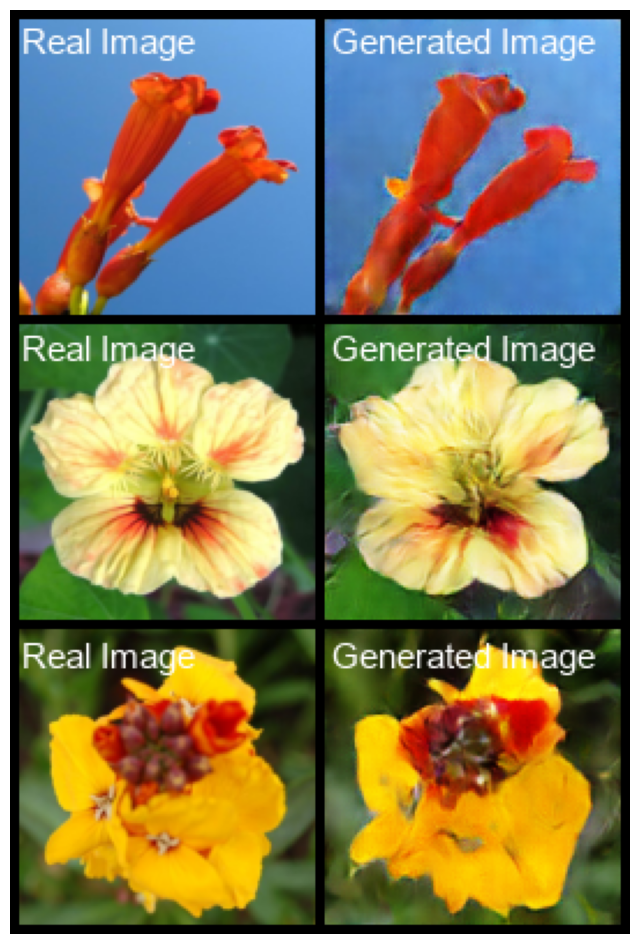

In [76]:
# Plot a real image next to the generated image with label
import matplotlib.pyplot as plt
from torchvision.transforms import ToPILImage
from PIL import ImageDraw, ImageFont

generator.eval()

NUM_IMAGES = 3
IMG_IDX = [7958, 688, 1000]  

real_images = []
generated_images = []

for idx in IMG_IDX:
    noise = torch.randn(size=(1, 100))
    real_image = ds[idx]['image'].unsqueeze(0)
    text_embedding = ds[idx]['embed_caption'].unsqueeze(0)

    with torch.no_grad():
        test_images = generator(noise.to(device), text_embedding.to(device))

    real_images.append(real_image)
    generated_images.append(test_images.cpu())

combined_images = torch.stack(
    [torch.cat((real_images[i], generated_images[i]), dim=0) for i in range(NUM_IMAGES)]
).view(-1, *real_images[0].shape[1:])

grid = torchvision.utils.make_grid(combined_images, nrow=2, normalize=True, padding=4)

grid_image = ToPILImage()(grid)

draw = ImageDraw.Draw(grid_image)

font = ImageFont.truetype("arial.ttf", size=15)  

img_width = grid_image.width // 2
img_height = grid_image.height // NUM_IMAGES

for i in range(NUM_IMAGES):
    draw.text((5, i * img_height + 5), "Real Image", (255, 255, 255), font=font)
    draw.text((img_width + 5, i * img_height + 5), "Generated Image", (255, 255, 255), font=font)

plt.figure(figsize=(12, 12))  
plt.imshow(grid_image)
plt.axis('off')
plt.show()